In [1]:
from torchvision import models                      
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import torch
import torchvision.transforms as tf
import segmentation_models_pytorch
from PIL import Image
from os import listdir
from os.path import isfile, join
from pathlib import Path
import cv2
import matplotlib.pyplot as plt

device = torch.device('cuda') if torch.cuda.is_available() else torch.device(
    'cpu')  # Check if there is GPU if not set trainning to CPU (very slow)


modelPath = "4000.torch"
width, height = 256, 256  # image width and height

Learning_Rate=1e-5
batchSize=16

transformImg = tf.Compose([tf.Resize((height, width)), tf.ToTensor(), tf.Normalize((0.485, 0.456, 0.406),
                                                                                   (0.229, 0.224, 0.225))])


data_paths_images = Path("/media/artem/A2F4DEB0F4DE85C7/myData/datasets/barcodes_hw/Train-20220427T142232Z-001/Train/Images")
data_paths_labels = Path("/media/artem/A2F4DEB0F4DE85C7/myData/datasets/barcodes_hw/Train-20220427T142232Z-001/Train/markup.csv")


onlyfiles_paths_images = {f: join(data_paths_images, f) for f in listdir(data_paths_images) if isfile(join(data_paths_images, f))}
from collections import defaultdict

dataset = defaultdict(str)

with open(data_paths_labels, 'rb') as f:
    contents = f.read().decode("utf-16").split("\n")
    for sample in contents:
        sample = str(sample)
        data = sample.split(",")
        
        dataset[data[0]] = data[1:]


seg_model = segmentation_models_pytorch.UnetPlusPlus(in_channels=3, classes=1)
seg_model.load_state_dict(torch.load(modelPath))
seg_model.to(device).eval()


UnetPlusPlus(
  (encoder): ResNetEncoder(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=Tru

In [2]:
def scan_for_barcode_orintation(barcode):
    row_num_errors = 0
    # Otsu's thresholding
    gray = cv2.cvtColor(barcode, cv2.COLOR_BGR2GRAY)
    ret2,th2 = cv2.threshold(gray,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
    plt.imshow(th2)  # display image
    plt.show()
    
    orin_tr = 0.5
    for idx, row in enumerate(th2):
        if idx == 0:
            cur_row = row
            continue
        if np.sum(np.logical_xor(row, cur_row)) / len(cur_row) > orin_tr:
            row_num_errors += 1
        cur_row = row
        
    col_num_errors = 0
    
    for idx, col_idx in enumerate(range(th2.shape[1])):
        col = th2[:, col_idx]
        if idx == 0:
            cur_col = col
            continue
        if np.sum(np.logical_xor(col, cur_col)) / len(cur_col) > orin_tr:
            col_num_errors += 1
        cur_col = col
    
    print(col_num_errors, row_num_errors)
    # Поворачиваем изображение чтобы линии были вертикально
    if col_num_errors < row_num_errors:
        print("rot 90")
        barcode = np.rot90(barcode)
        th2 = np.rot90(th2)
    
    # Проверяем что штрихкод не перевернут верх дном
    h, w = th2.shape
    upper_part_barcode = th2[:h // 10, :]
    
    upper_freq_errors = 0
    freq_tr = 0.05
    for idx, row in enumerate(upper_part_barcode):
        if idx == 0:
            cur_row = row
            continue
        if np.sum(np.logical_xor(row, cur_row)) / len(cur_row) > freq_tr:
            upper_freq_errors += 1
        cur_row = row

    low_freq_errors = 0
    lower_part_barcode = th2[h - h // 10:, :]
    
    for idx, row in enumerate(lower_part_barcode):
        if idx == 0:
            cur_row = row
            continue
        if np.sum(np.logical_xor(row, cur_row)) / len(cur_row) > freq_tr:
            low_freq_errors += 1
        cur_row = row

    print(low_freq_errors, upper_freq_errors)
    if low_freq_errors < upper_freq_errors:
        print("rot 180")
        barcode = np.rot90(barcode)
        barcode = np.rot90(barcode)
        
    return barcode
    
def getSubImage(best_area, src):
    # Get center, size, and angle from rect
    pts1 = np.float32(best_area)
    pts2 = np.float32([[300, 300], [0, 300], [0, 0], [300, 0]])
    M = cv2.getPerspectiveTransform(pts1, pts2)
    out = cv2.warpPerspective(src, M, (300, 300))
    
    return out

def cutBarcode(x):
    width_orgin, height_orgin = x.size[0], x.size[1]  # Get image original size

    Img = transformImg(x)  # Transform to pytorch
    Img = torch.autograd.Variable(Img, requires_grad=False).to(device).unsqueeze(0)

    with torch.no_grad():
        Prd = seg_model(Img) 

    Prd = tf.Resize((height_orgin, width_orgin))(Prd[0])[0]  # Resize to origninal size

    mask = Prd.detach().cpu().numpy() > 0.5
    mask_img = mask.astype(np.uint8)
    plt.imshow(mask_img)  # display image
    plt.show()

    w, h = mask_img.shape
    len_barcode = int(np.sqrt(np.sum(mask_img)))
    
    #mask_img = cv2.dilate(mask_img, np.ones((len_barcode // 10, len_barcode // 10)))
    mask_img *= 255
    
    
    plt.imshow(x)  # display image
    plt.show()

    #     plt.imshow(mask_img)  # display image
    #     plt.show()
    
    Img_orig = x
    contours, _ = cv2.findContours(mask_img, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    best_area = []
    max_S = -1
    
    for cnt in contours:
        area = cv2.contourArea(cnt)
        if area > max_S:
            epsilon = 0.1*cv2.arcLength(cnt,True)

            
            tmp_area = cv2.approxPolyDP(cnt,epsilon,True)
            if len(tmp_area) == 4:
                best_area = tmp_area
                max_S = area
   
    if len(best_area) != 4:
        for cnt in contours:
            area = cv2.contourArea(cnt)
            if area > max_S:
                epsilon = 0.1*cv2.arcLength(cnt,True)

                tmp_area = cv2.approxPolyDP(cnt,epsilon,True)
                print(tmp_area)
                best_area = []
                
                best_area.append(tmp_area[0])
                best_area.append([[tmp_area[0][0][0], tmp_area[1][0][1]]])
                best_area.append(tmp_area[1])
                best_area.append([[tmp_area[1][0][0], tmp_area[0][0][1]]])
                max_S = area

    print(best_area)
    Img_orig = np.array(Img_orig)
    barcode = getSubImage(best_area, Img_orig)
    barcode = scan_for_barcode_orintation(barcode)
    plt.imshow(barcode)  # display image
    plt.show()

    return barcode               

In [3]:
def ReadRandomImage(onlyfiles_paths_images, dataset): # First lets load random image and  the corresponding annotation    
    idx = np.random.randint(0,len(onlyfiles_paths_images)) # Select random image
    name = list(onlyfiles_paths_images.keys())[idx]
    sample = dataset[name]
    
    while len(sample) == 0: # check empty sample
        idx = np.random.randint(0,len(onlyfiles_paths_images)) # Select random image
        name = list(onlyfiles_paths_images.keys())[idx]
        sample = dataset[name]

    img_file_path =  onlyfiles_paths_images[name]
    
    Img =  cutBarcode(Image.open(img_file_path, mode='r', formats=None))
    Img = Image.fromarray(np.uint8(Img)).convert('RGB')

    Img = transformImg(Img)

    AnnMap = torch.Tensor([int(i) for i in sample[0]])
    return Img, AnnMap

#--------------Load batch of images-----------------------------------------------------
def LoadBatch(onlyfiles_paths_images, dataset): # Load batch of images
    images = torch.zeros([batchSize,3,height,width])
    anns = torch.zeros([batchSize,13])
    
    for i in range(batchSize):
        image,ann=ReadRandomImage(onlyfiles_paths_images, dataset)
        images[i] = image
        anns[i] = ann
        
    return images, anns

class Model(nn.Module):
    def __init__(self):
        super().__init__()
        self.model = nn.Sequential(models.mobilenet_v3_small(pretrained=True), 
                                   nn.ReLU(),
                                   nn.Linear(1000, 100),
                                   nn.ReLU())
        
        self.digit_2 = nn.Linear(100, 10)
        self.digit_3 = nn.Linear(100, 10)
        self.digit_4 = nn.Linear(100, 10)
        self.digit_5 = nn.Linear(100, 10)
        self.digit_6 = nn.Linear(100, 10)
        self.digit_7 = nn.Linear(100, 10)
        
        self.digit_1 = nn.Linear(60, 10)
        
        self.digit_8 = nn.Linear(100, 10)
        self.digit_9 = nn.Linear(100, 10)
        self.digit_10 = nn.Linear(100, 10)
        self.digit_11 = nn.Linear(100, 10)
        self.digit_12 = nn.Linear(100, 10)
        self.digit_13 = nn.Linear(100, 10)

        self.softmax = nn.Softmax()
    
    def forward(self, barcode):
        features = self.model(barcode)
        df2 = self.digit_2(features) 
        df3 = self.digit_3(features) 
        df4 = self.digit_4(features) 
        df5 = self.digit_5(features) 
        df6 = self.digit_6(features) 
        df7 = self.digit_7(features)
        
        left_features = torch.cat([df2, df3, df4, df5, df6, df7], dim=1)
        df1 = self.digit_1(left_features)
        
        df8 = self.digit_8(features)
        df9 = self.digit_9(features)
        df10 = self.digit_10(features)
        df11 = self.digit_11(features)
        df12 = self.digit_12(features)
        df13 = self.digit_13(features)
         
        pd1 = self.softmax(df1).unsqueeze(1) 
        pd2 = self.softmax(df2).unsqueeze(1)
        pd3 = self.softmax(df3).unsqueeze(1)
        pd4 = self.softmax(df4).unsqueeze(1)
        pd5 = self.softmax(df5).unsqueeze(1)
        pd6 = self.softmax(df6).unsqueeze(1)
        pd7 = self.softmax(df7).unsqueeze(1)
        pd8 = self.softmax(df8).unsqueeze(1)
        pd9 = self.softmax(df9).unsqueeze(1)
        pd10 = self.softmax(df10).unsqueeze(1)
        pd11 = self.softmax(df11).unsqueeze(1)
        pd12 = self.softmax(df12).unsqueeze(1)
        pd13 = self.softmax(df13).unsqueeze(1)
        
        ans = torch.cat([pd1, pd2, pd3, pd4, pd5, pd6, pd7, pd8, pd9, pd10, pd11, pd12, pd13], dim=1)
        
        return ans


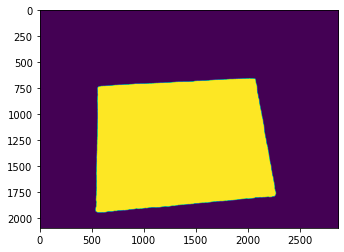

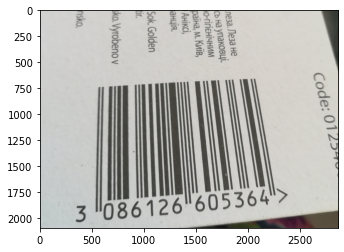

[[[2066  663]]

 [[ 558  737]]

 [[ 535 1930]]

 [[2248 1785]]]


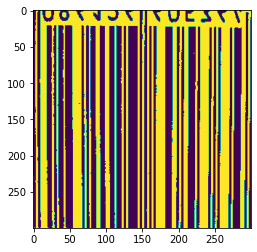

42 0
0 12
rot 180


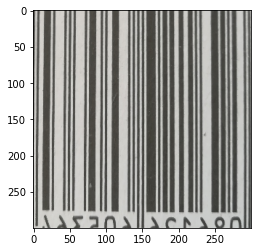

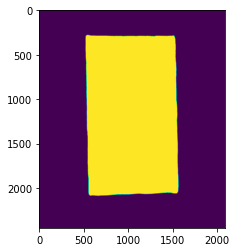

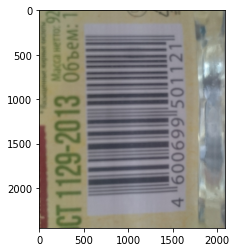

[[[ 532  284]]

 [[ 561 2070]]

 [[1549 2059]]

 [[1524  293]]]


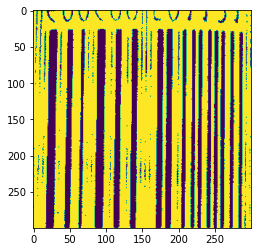

7 0
0 13
rot 180


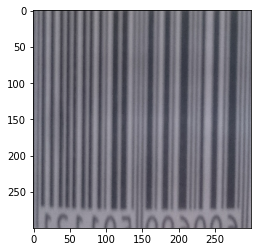

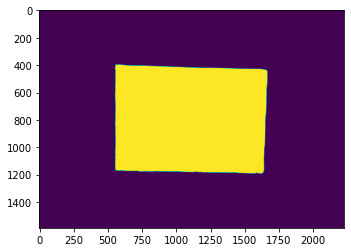

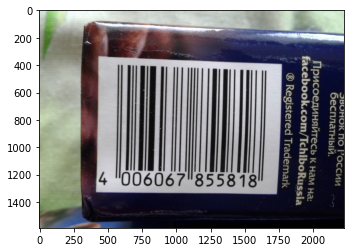

[[[ 557  400]]

 [[ 560 1167]]

 [[1637 1181]]

 [[1655  434]]]


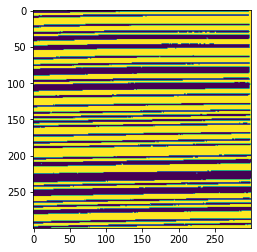

0 16
rot 90
0 2
rot 180


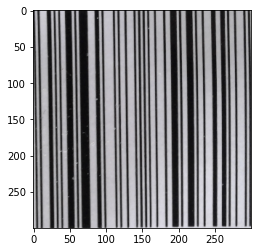

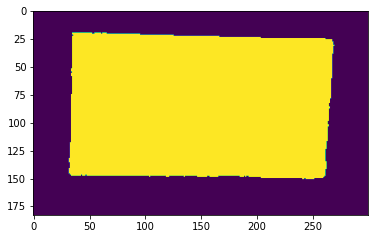

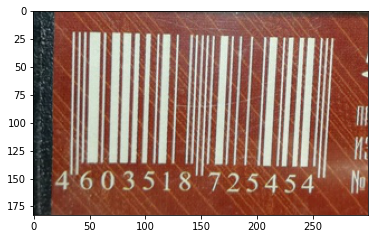

[[[ 35  20]]

 [[ 34 147]]

 [[261 147]]

 [[267  26]]]


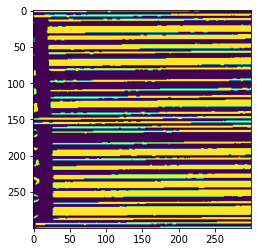

0 15
rot 90
6 0


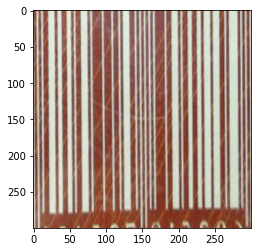

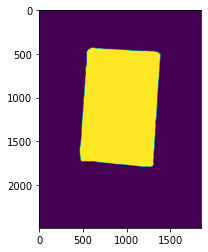

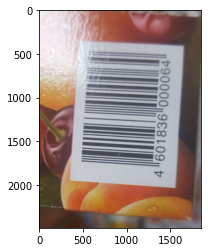

[[[ 590  435]]

 [[ 480 1721]]

 [[1292 1789]]

 [[1385  504]]]


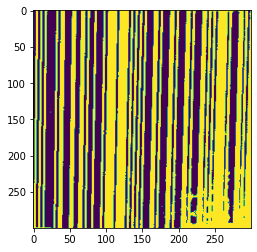

0 0
1 1


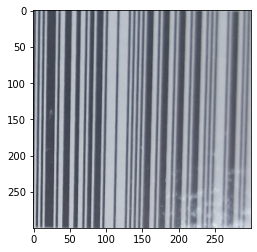

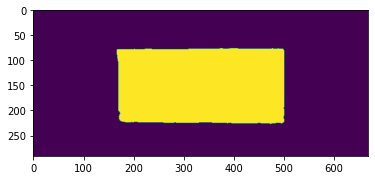

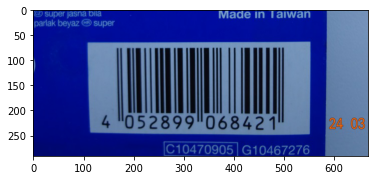

[[[500  80]]

 [[168  78]]

 [[172 218]]

 [[496 225]]]


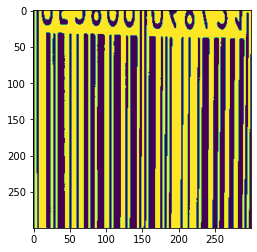

44 0
0 5
rot 180


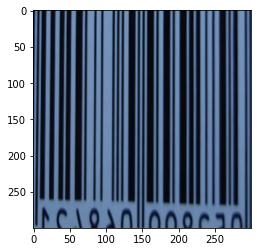

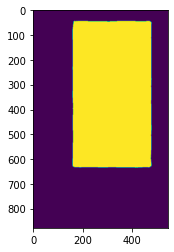

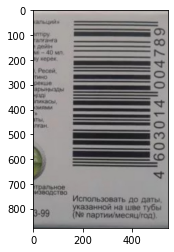

[[[164  45]]

 [[161 630]]

 [[471 631]]

 [[476  50]]]


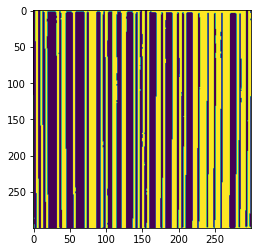

59 0
0 3
rot 180


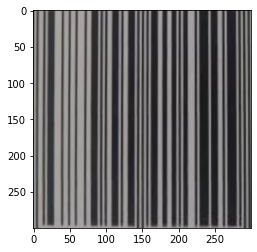

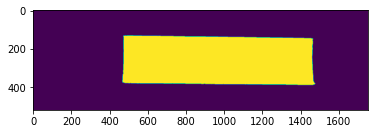

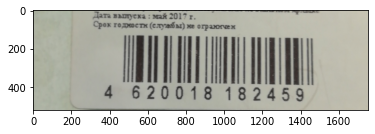

[[[ 472  135]]

 [[1475  383]]]
[array([[472, 135]], dtype=int32), [[472, 383]], array([[1475,  383]], dtype=int32), [[1475, 135]]]


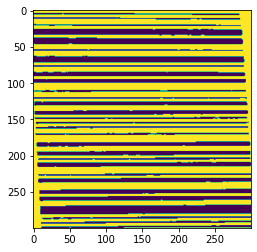

0 57
rot 90
0 0


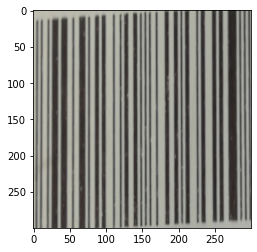

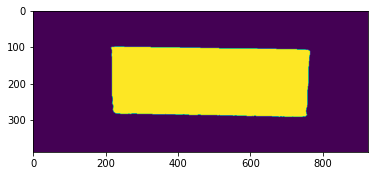

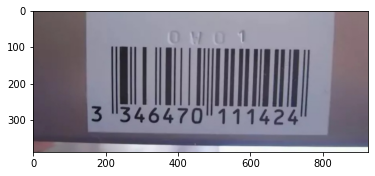

[[[215 101]]

 [[227 281]]

 [[756 286]]

 [[759 107]]]


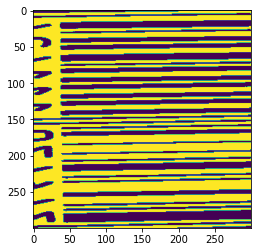

0 1
rot 90
2 0


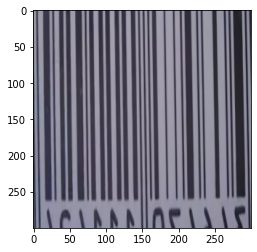

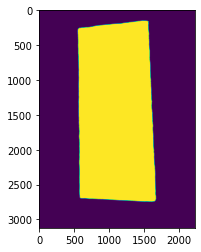

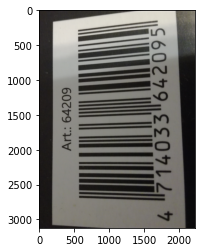

[[[1553  157]]

 [[ 558  271]]

 [[ 590 2690]]

 [[1664 2723]]]


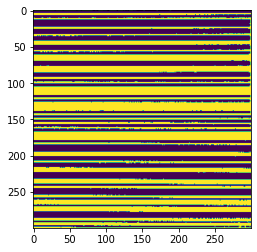

0 58
rot 90
1 2
rot 180


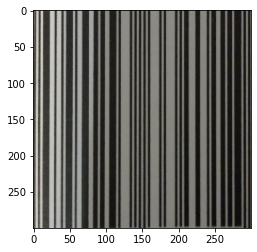

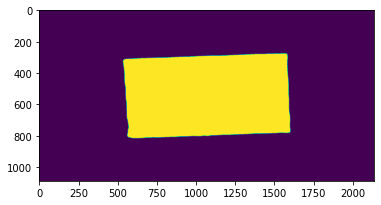

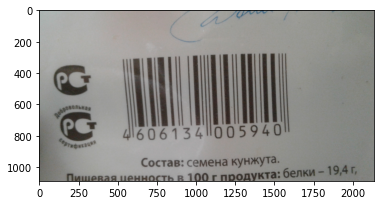

[[[1582  280]]

 [[ 543  314]]

 [[ 563  801]]

 [[1599  780]]]


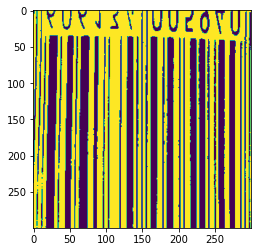

37 0
0 7
rot 180


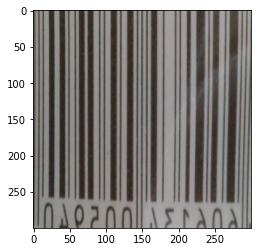

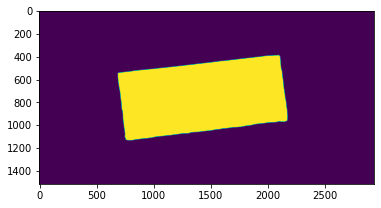

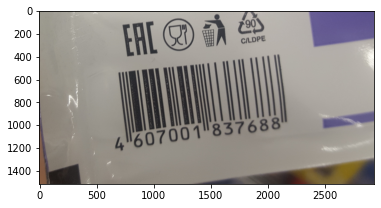

[[[2105  393]]

 [[ 692  542]]

 [[ 761 1123]]

 [[2168  959]]]


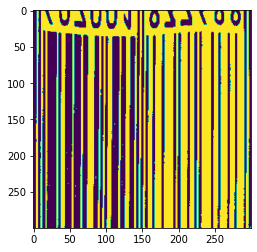

43 0
0 8
rot 180


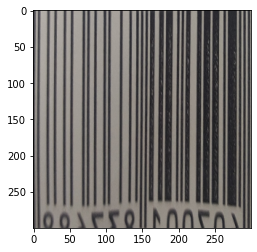

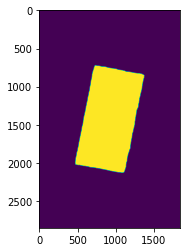

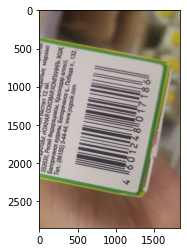

[[[ 739  722]]

 [[ 475 2010]]

 [[1108 2126]]

 [[1382  863]]]


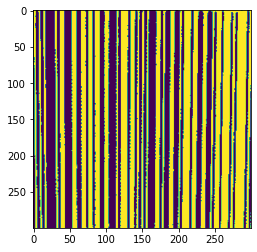

26 0
0 1
rot 180


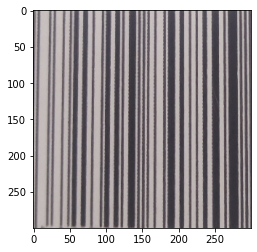

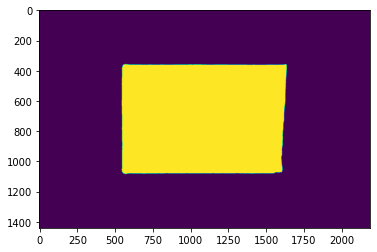

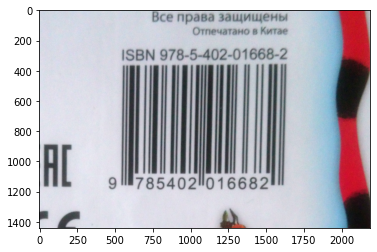

[[[ 554  362]]

 [[ 557 1078]]

 [[1603 1070]]

 [[1636  361]]]


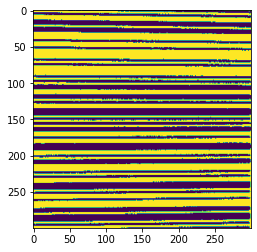

0 30
rot 90
0 2
rot 180


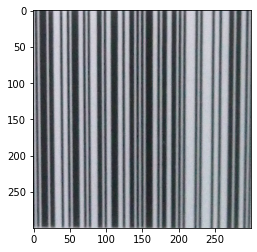

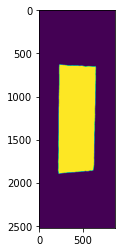

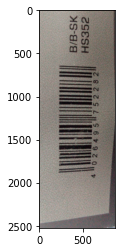

[[[ 239  629]]

 [[ 224 1886]]

 [[ 616 1859]]

 [[ 649  651]]]


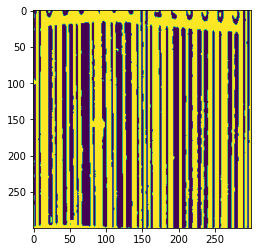

49 0
0 2
rot 180


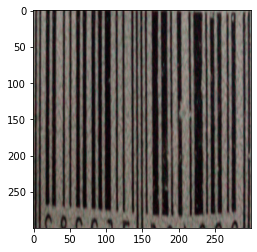

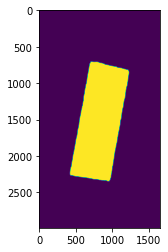

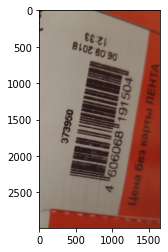

[[[ 715  707]]

 [[ 424 2247]]

 [[ 958 2346]]

 [[1233  843]]]


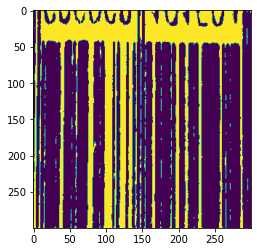

29 0
0 8
rot 180


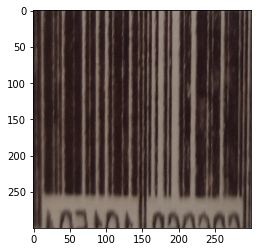

Saving Model0.torch
0 ) Loss= 29.987076
tensor([[0.1177, 0.1407, 0.0951, 0.0963, 0.1112, 0.0594, 0.0692, 0.1207, 0.1132,
         0.0764],
        [0.1120, 0.0990, 0.1212, 0.0526, 0.1832, 0.0626, 0.0776, 0.1100, 0.0586,
         0.1232],
        [0.0948, 0.1134, 0.1549, 0.0453, 0.1252, 0.0784, 0.0639, 0.1592, 0.0419,
         0.1230],
        [0.0814, 0.1716, 0.0632, 0.0547, 0.1827, 0.0894, 0.1814, 0.0704, 0.0368,
         0.0686],
        [0.0975, 0.0749, 0.1042, 0.1320, 0.1019, 0.0808, 0.1160, 0.1547, 0.0728,
         0.0652],
        [0.2482, 0.0512, 0.0523, 0.0980, 0.1681, 0.0782, 0.0618, 0.0722, 0.0553,
         0.1147],
        [0.1280, 0.0845, 0.0539, 0.0823, 0.0481, 0.1051, 0.1010, 0.0813, 0.2420,
         0.0739],
        [0.0472, 0.0591, 0.1205, 0.0644, 0.1536, 0.1637, 0.1379, 0.1193, 0.0567,
         0.0776],
        [0.0395, 0.1391, 0.1711, 0.0529, 0.0780, 0.1291, 0.1015, 0.1363, 0.0781,
         0.0744],
        [0.0907, 0.0839, 0.0694, 0.0503, 0.1861, 0.0707, 0.1619, 0.11

/home/artem/anaconda3/envs/CenterNetRefs/lib/python3.7/site-packages/ipykernel_launcher.py:78: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
/home/artem/anaconda3/envs/CenterNetRefs/lib/python3.7/site-packages/ipykernel_launcher.py:79: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
/home/artem/anaconda3/envs/CenterNetRefs/lib/python3.7/site-packages/ipykernel_launcher.py:80: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
/home/artem/anaconda3/envs/CenterNetRefs/lib/python3.7/site-packages/ipykernel_launcher.py:81: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
/home/artem/anaconda3/envs/CenterNetRefs/lib/python3.7/site-packages/ipykernel_launcher.py:82: UserWarning: Implicit dimension choice fo

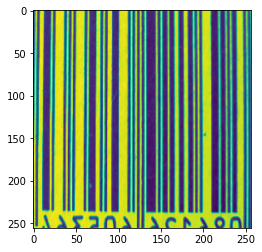

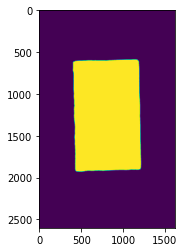

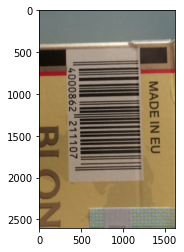

[[[1176  593]]

 [[ 409  619]]

 [[ 450 1925]]

 [[1214 1893]]]


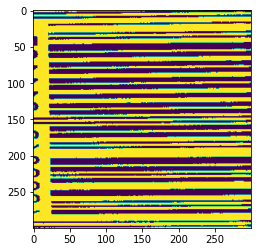

0 9
rot 90
11 0


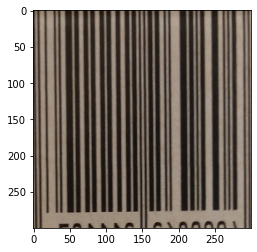

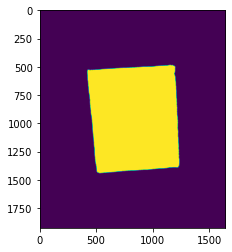

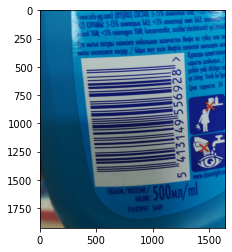

[[[1191  495]]

 [[ 421  528]]

 [[ 510 1435]]

 [[1224 1384]]]


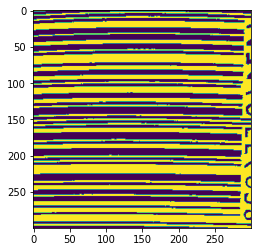

0 31
rot 90
0 12
rot 180


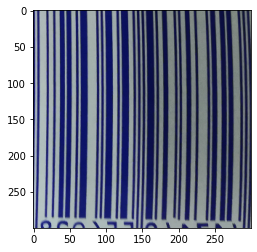

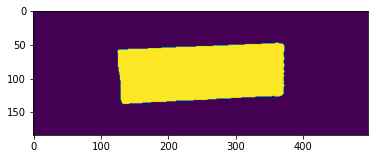

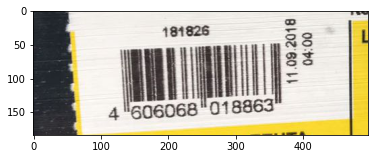

[[[372  51]]

 [[127  57]]

 [[131 134]]

 [[368 125]]]


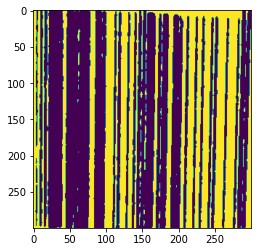

10 0
0 0


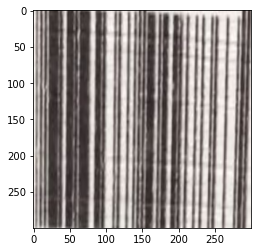

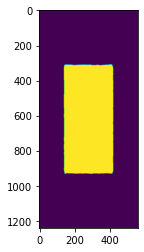

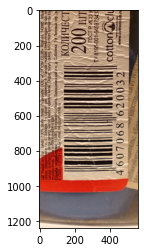

[[[408 308]]

 [[143 314]]

 [[147 932]]

 [[416 925]]]


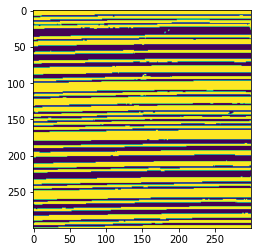

0 27
rot 90
0 0


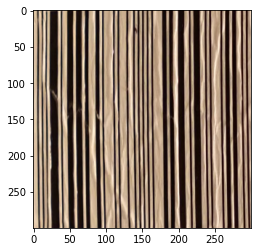

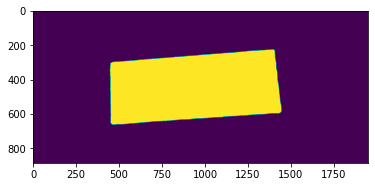

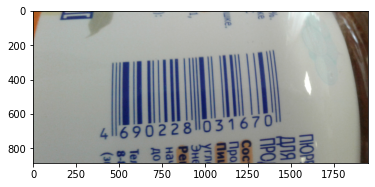

[[[1406  229]]

 [[ 461  297]]

 [[ 451  648]]

 [[1433  593]]]


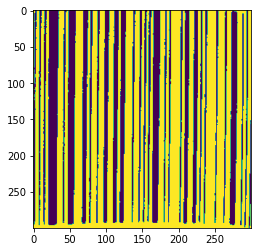

25 0
2 0


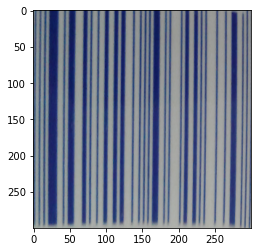

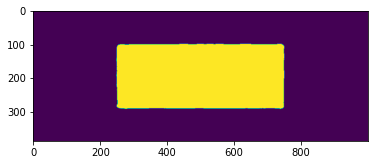

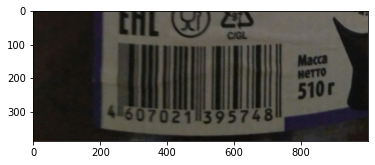

[[[251 104]]

 [[253 288]]

 [[748 286]]

 [[744  99]]]


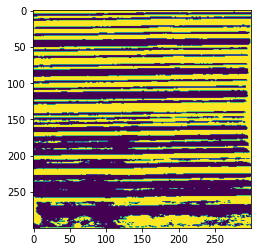

0 2
rot 90
0 2
rot 180


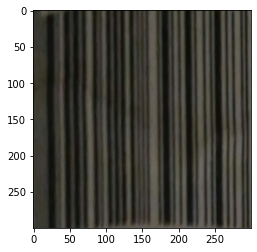

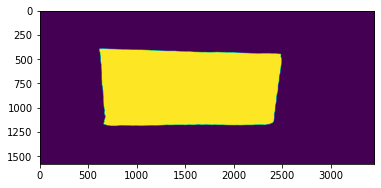

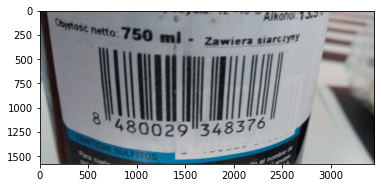

[[[ 613  398]]

 [[ 668 1175]]

 [[2410 1138]]

 [[2482  452]]]


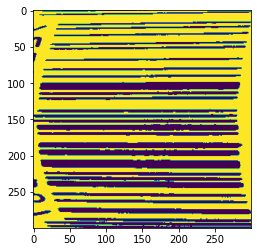

0 24
rot 90
3 0


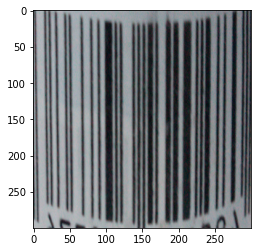

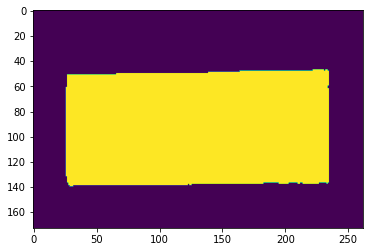

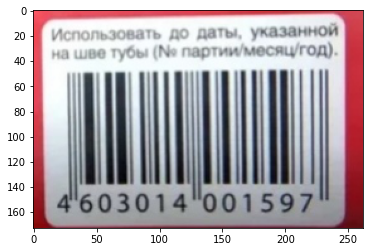

[[[234  48]]

 [[ 27  51]]

 [[ 27 136]]

 [[233 137]]]


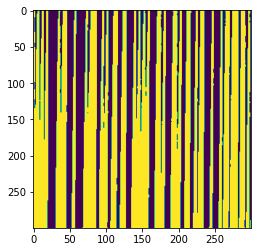

23 0
0 0


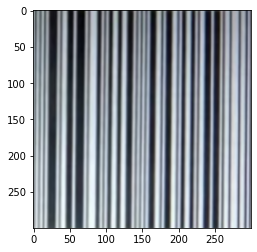

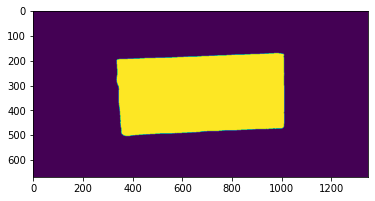

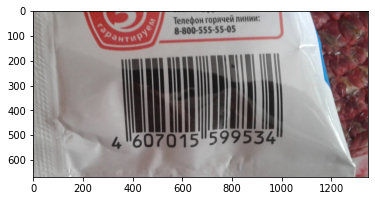

[[[1009  174]]

 [[ 339  194]]

 [[ 357  494]]

 [[1002  471]]]


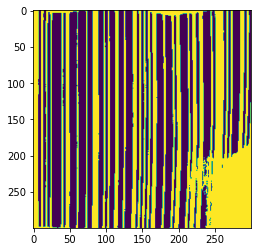

37 0
1 3
rot 180


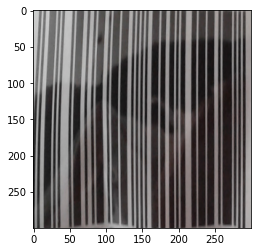

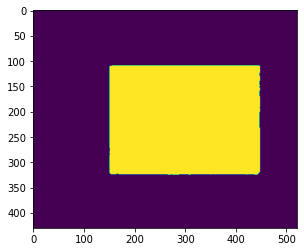

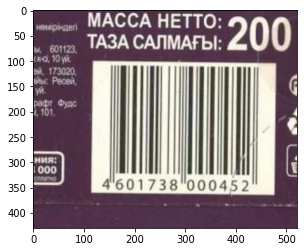

[[[151 111]]

 [[152 322]]

 [[447 320]]

 [[448 110]]]


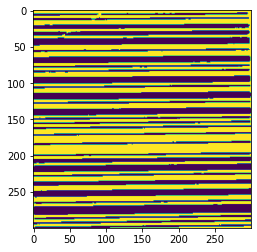

0 15
rot 90
1 2
rot 180


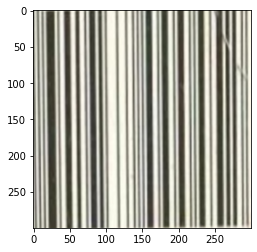

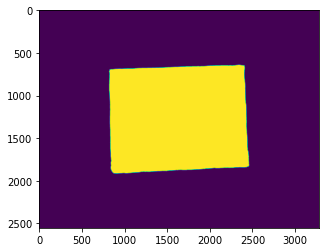

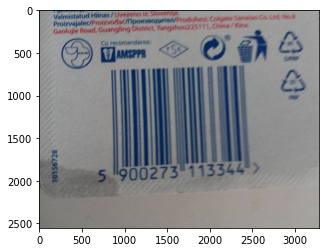

[[[2405  652]]

 [[ 825  700]]

 [[ 859 1899]]

 [[2450 1833]]]


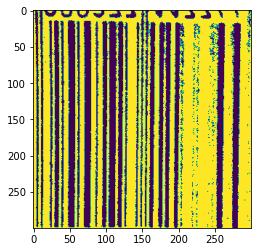

25 0
6 26
rot 180


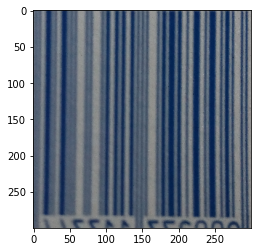

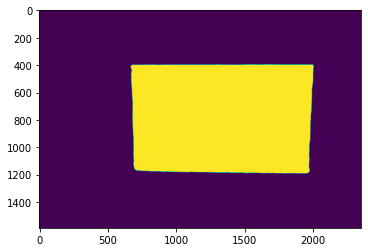

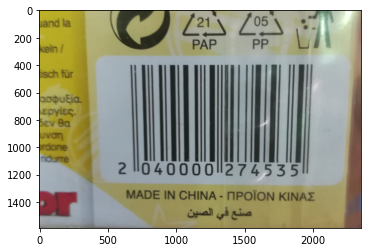

[[[2002  401]]

 [[ 678  400]]

 [[ 700 1162]]

 [[1961 1188]]]


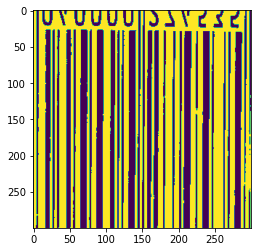

48 0
0 11
rot 180


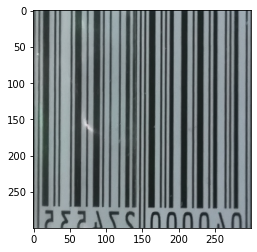

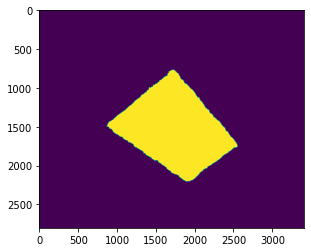

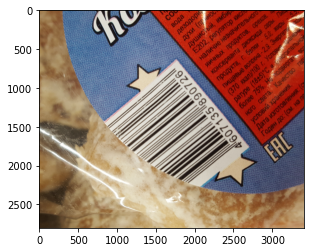

[[[1712  770]]

 [[ 872 1494]]

 [[1913 2204]]

 [[2557 1744]]]


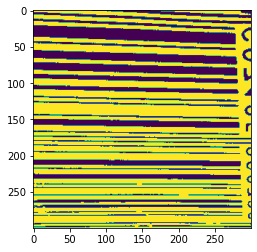

0 27
rot 90
0 11
rot 180


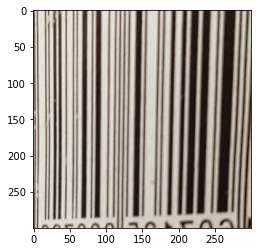

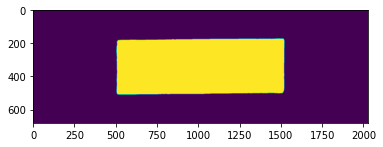

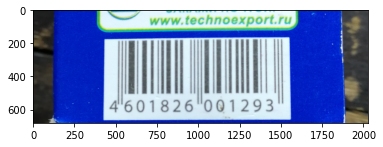

[[[1520  180]]

 [[ 515  181]]

 [[ 507  499]]

 [[1509  500]]]


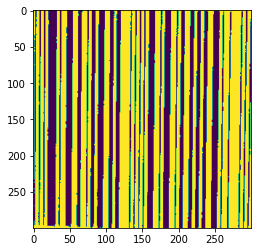

20 0
1 1


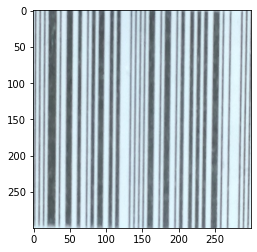

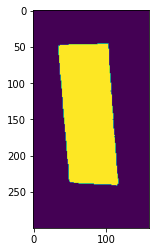

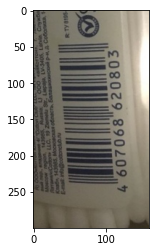

[[[ 37  48]]

 [[ 50 235]]

 [[115 241]]

 [[103  46]]]


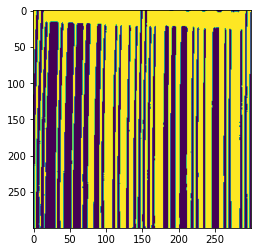

28 0
0 3
rot 180


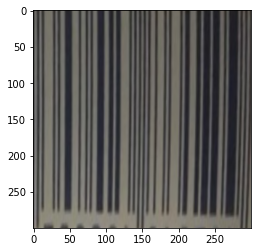

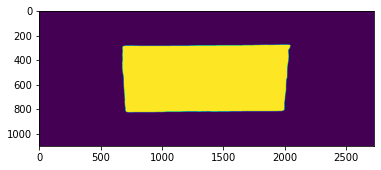

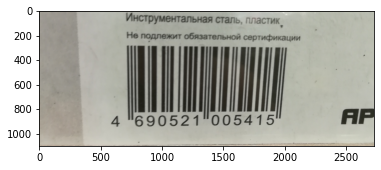

[[[2050  281]]

 [[ 688  285]]

 [[ 708  818]]

 [[1990  811]]]


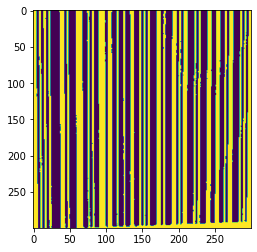

44 0
5 0


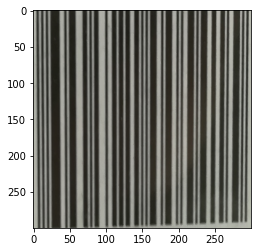

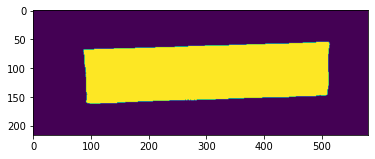

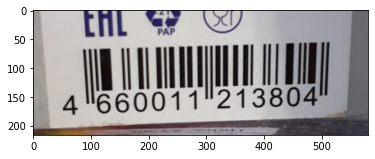

[[[514  58]]

 [[ 92 159]]]
[array([[514,  58]], dtype=int32), [[514, 159]], array([[ 92, 159]], dtype=int32), [[92, 58]]]


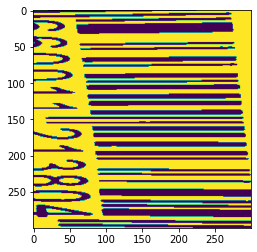

0 27
rot 90
0 0


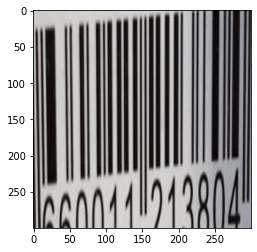

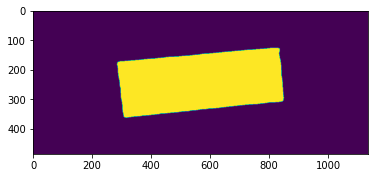

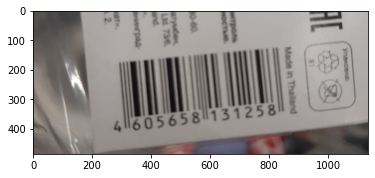

[[[836 127]]

 [[289 172]]

 [[307 356]]

 [[845 306]]]


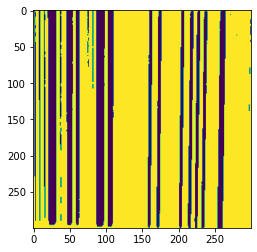

18 0
1 1


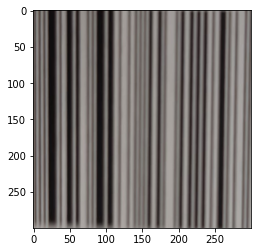

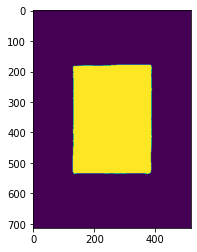

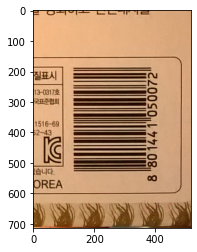

[[[385 180]]

 [[131 185]]

 [[135 535]]

 [[385 530]]]


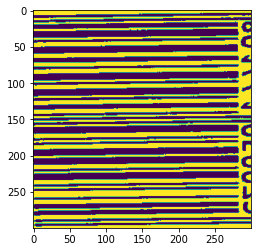

0 0
23 24
rot 180


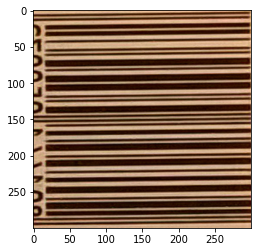

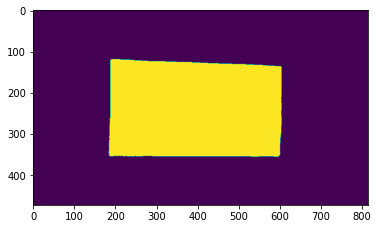

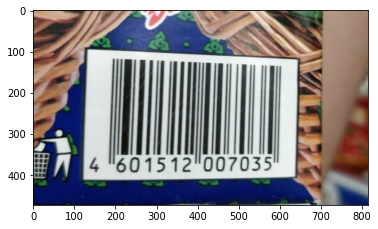

[[[188 121]]

 [[186 353]]

 [[600 351]]

 [[602 136]]]


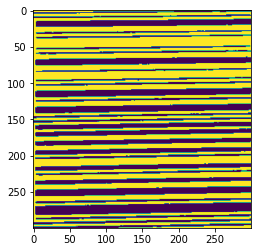

0 7
rot 90
2 0


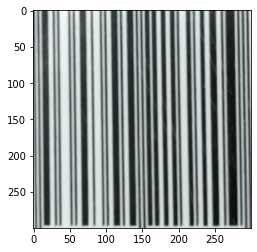

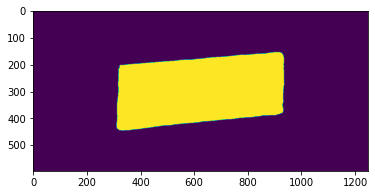

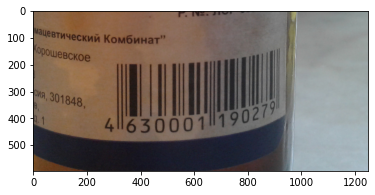

[[[933 166]]

 [[324 201]]

 [[312 436]]

 [[928 379]]]


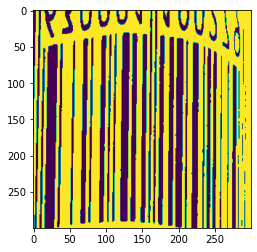

6 0
1 1


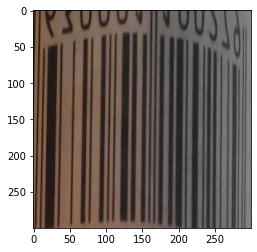

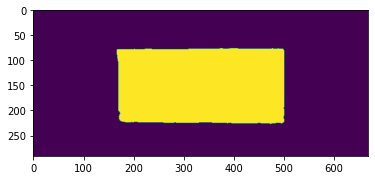

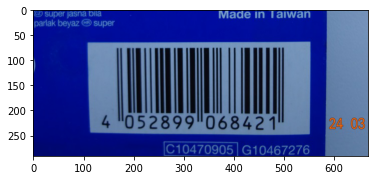

[[[500  80]]

 [[168  78]]

 [[172 218]]

 [[496 225]]]


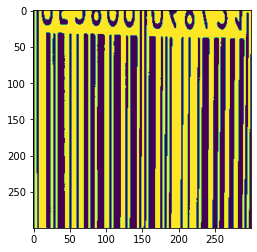

44 0
0 5
rot 180


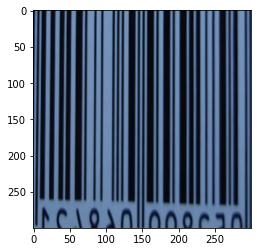

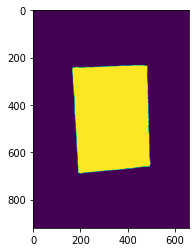

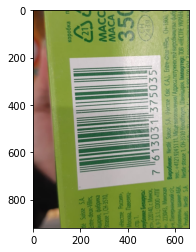

[[[481 235]]

 [[166 246]]

 [[193 687]]

 [[493 657]]]


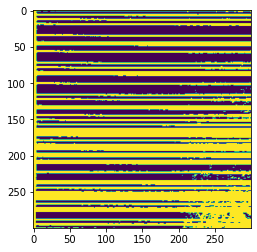

0 56
rot 90
3 0


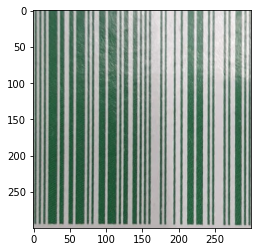

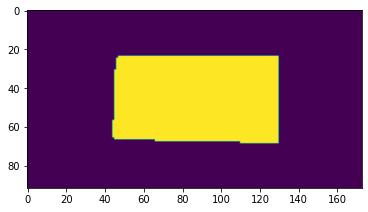

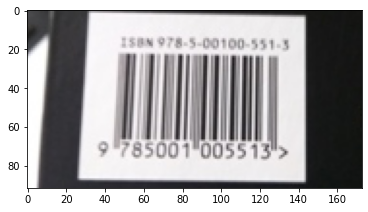

[[[ 46  25]]

 [[ 45  66]]

 [[129  68]]

 [[129  24]]]


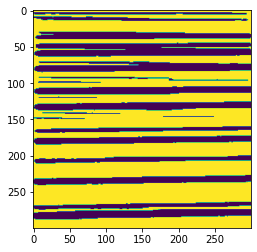

0 10
rot 90
1 0


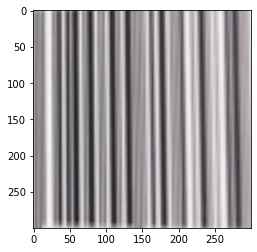

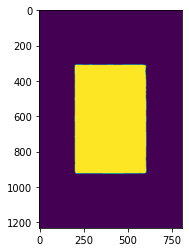

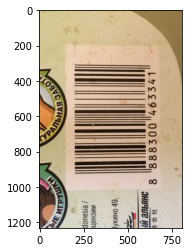

[[[203 311]]

 [[206 921]]

 [[603 920]]

 [[604 313]]]


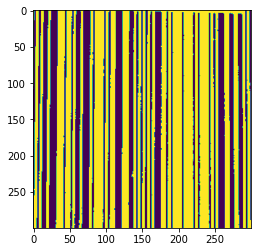

42 0
0 2
rot 180


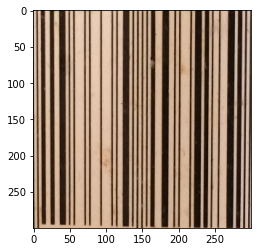

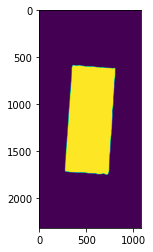

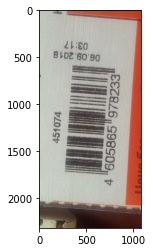

[[[ 355  587]]

 [[ 275 1705]]

 [[ 717 1749]]

 [[ 803  620]]]


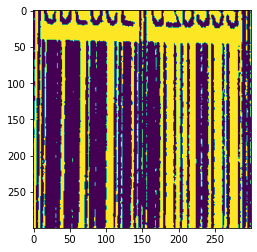

25 0
1 12
rot 180


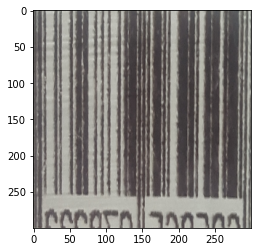

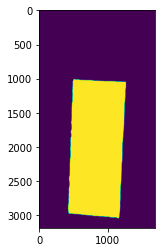

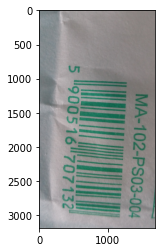

[[[ 506 1009]]

 [[ 431 2965]]

 [[1162 3041]]

 [[1269 1055]]]


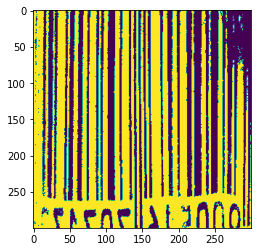

29 0
10 6


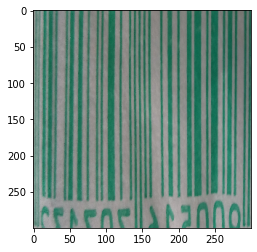

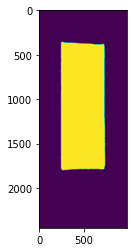

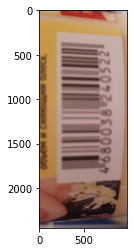

[[[ 255  352]]

 [[ 247 1780]]

 [[ 720 1788]]

 [[ 727  387]]]


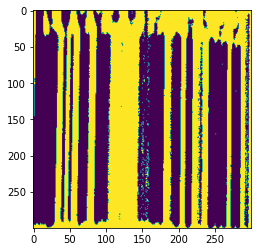

4 0
3 1


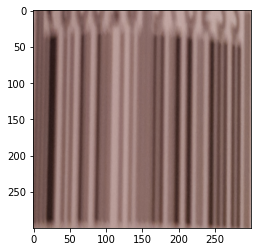

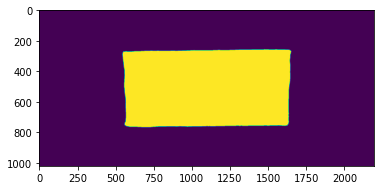

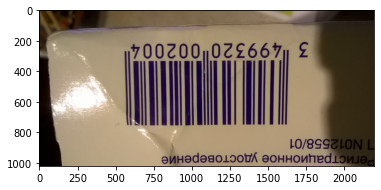

[[[1652  269]]

 [[ 552  272]]

 [[ 561  749]]

 [[1625  755]]]


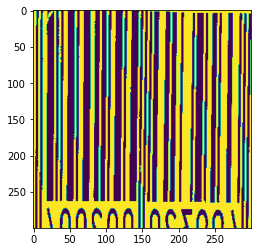

11 0
7 3


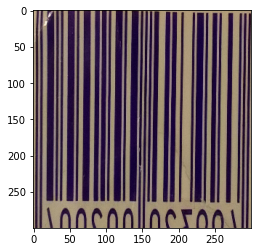

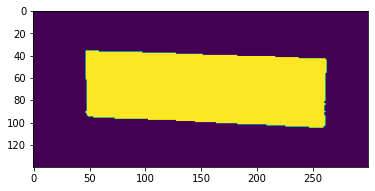

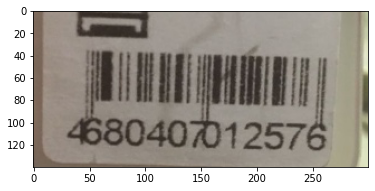

[[[ 47  36]]

 [[261 102]]

 [[261  43]]]
[array([[47, 36]], dtype=int32), [[47, 102]], array([[261, 102]], dtype=int32), [[261, 36]]]


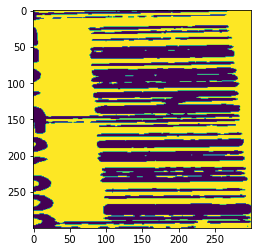

0 2
rot 90
3 0


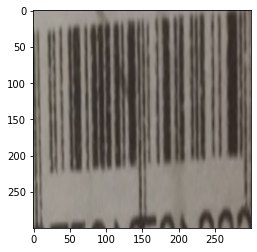

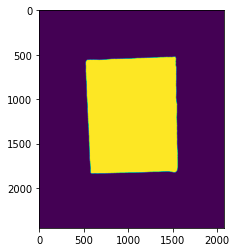

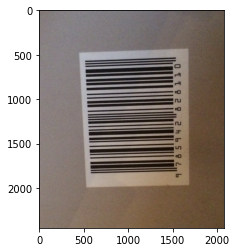

[[[1531  524]]

 [[ 531  569]]

 [[ 586 1832]]

 [[1548 1810]]]


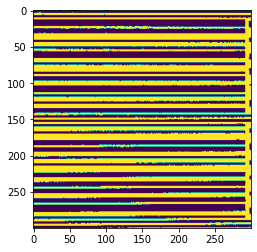

0 57
rot 90
0 2
rot 180


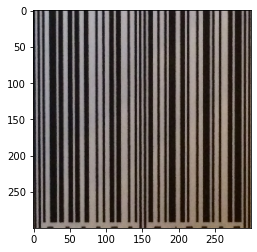

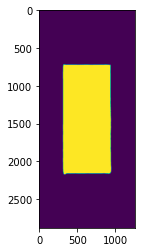

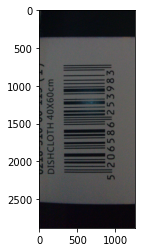

[[[ 328  716]]

 [[ 325 2165]]

 [[ 925 2162]]

 [[ 941  727]]]


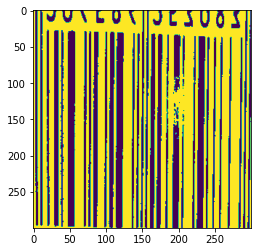

25 0
2 6
rot 180


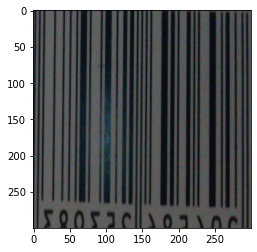

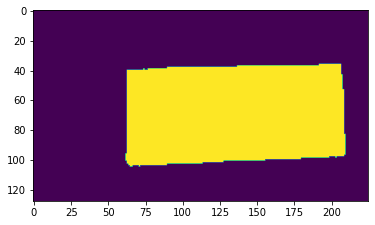

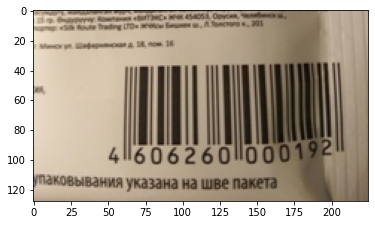

[[[206  36]]

 [[ 63  40]]

 [[ 62 100]]

 [[208  97]]]


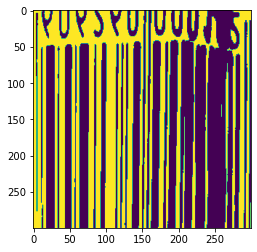

22 0
0 1
rot 180


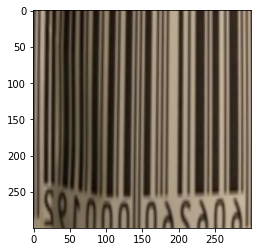

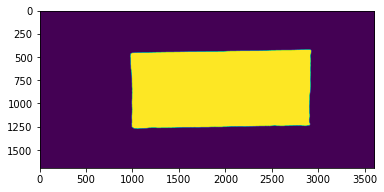

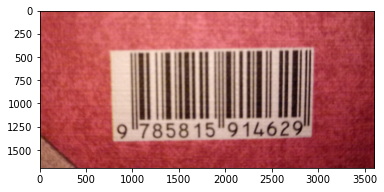

[[[2917  433]]

 [[ 987  461]]

 [[ 989 1251]]

 [[2899 1234]]]


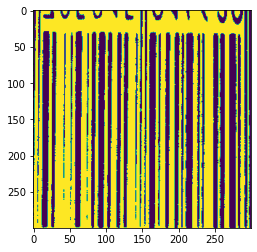

36 0
1 6
rot 180


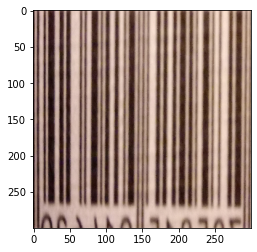

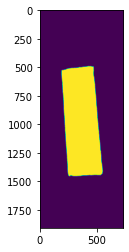

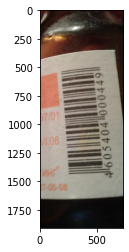

[[[ 456  493]]

 [[ 187  532]]

 [[ 255 1452]]

 [[ 542 1422]]]


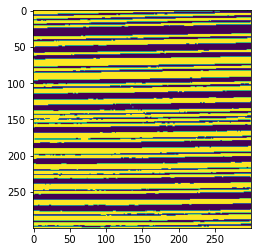

0 19
rot 90
1 0


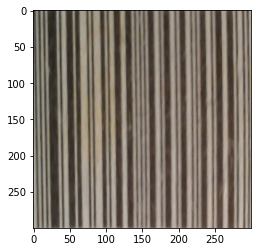

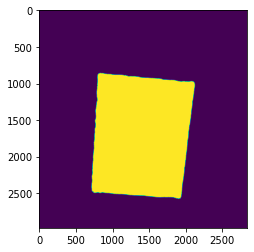

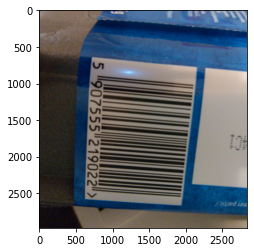

[[[ 817  864]]

 [[ 727 2475]]

 [[1927 2570]]

 [[2127  993]]]


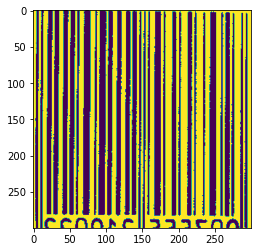

39 0
12 3


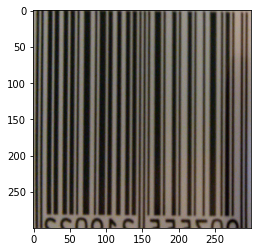

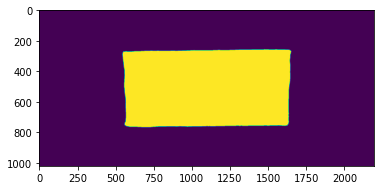

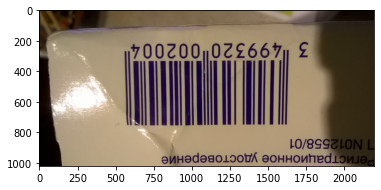

[[[1652  269]]

 [[ 552  272]]

 [[ 561  749]]

 [[1625  755]]]


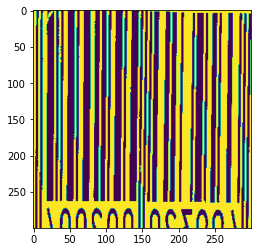

11 0
7 3


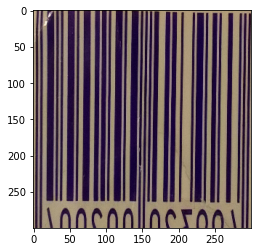

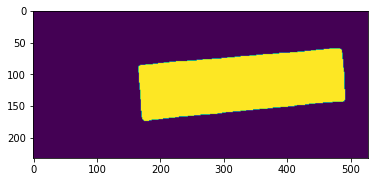

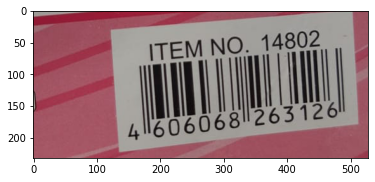

[[[486  62]]

 [[172 170]]]
[array([[486,  62]], dtype=int32), [[486, 170]], array([[172, 170]], dtype=int32), [[172, 62]]]


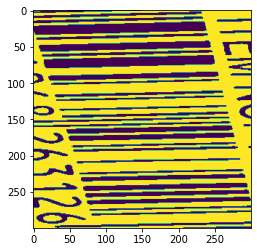

0 0
22 23
rot 180


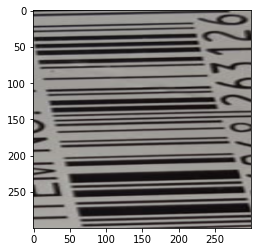

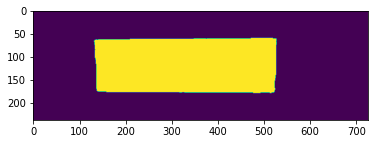

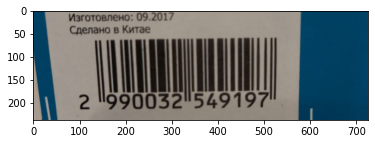

[[[527  62]]

 [[137  63]]

 [[138 173]]

 [[521 177]]]


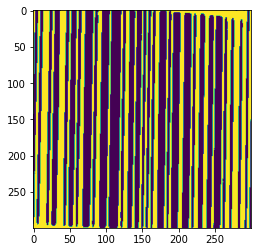

7 0
0 0


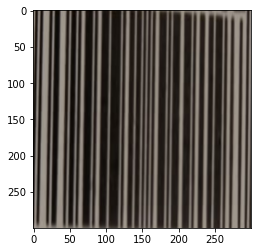

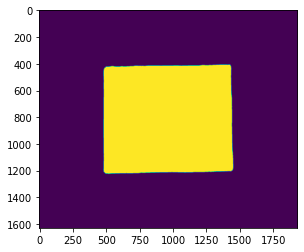

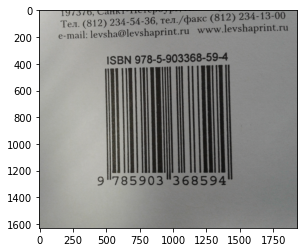

[[[1427  410]]

 [[ 498  425]]

 [[ 485 1210]]

 [[1441 1199]]]


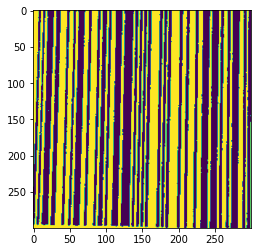

1 0
3 0


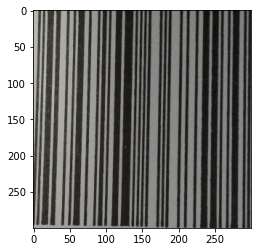

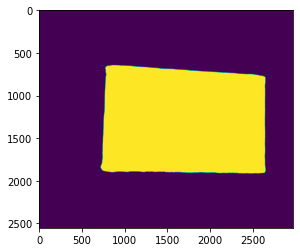

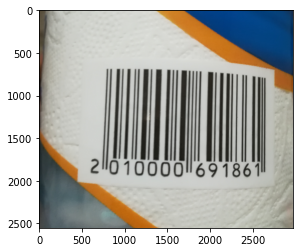

[[[ 780  668]]

 [[ 749 1880]]

 [[2648 1898]]

 [[2642  779]]]


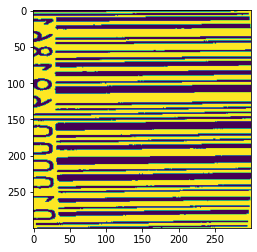

0 7
rot 90
9 0


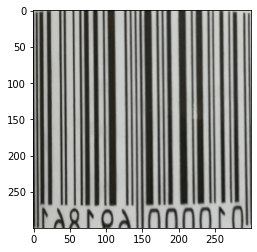

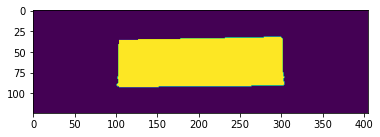

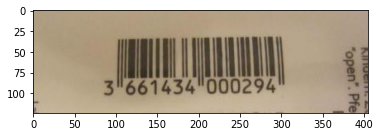

[[[301  34]]

 [[101  90]]

 [[302  90]]]
[array([[301,  34]], dtype=int32), [[301, 90]], array([[101,  90]], dtype=int32), [[101, 34]]]


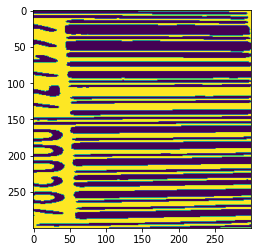

0 27
rot 90
0 0


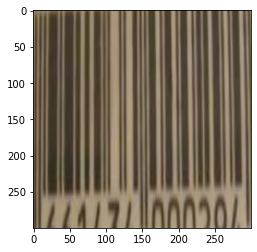

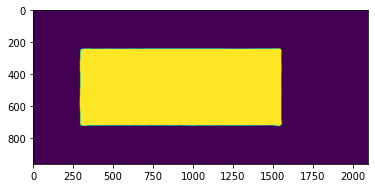

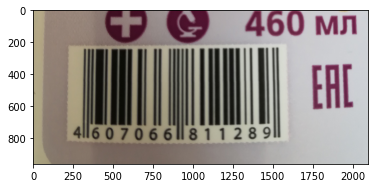

[[[1552  246]]

 [[ 301  244]]

 [[ 296  714]]

 [[1544  721]]]


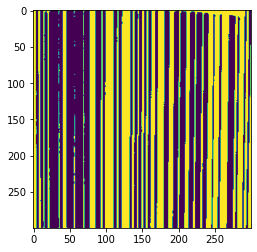

38 0
0 2
rot 180


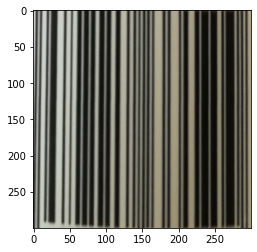

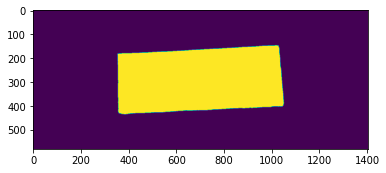

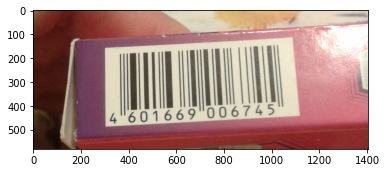

[[[1029  150]]

 [[ 355  182]]

 [[ 357  425]]

 [[1045  401]]]


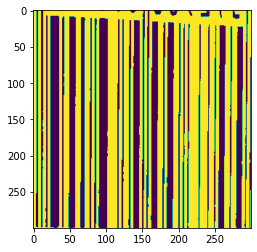

51 0
1 2
rot 180


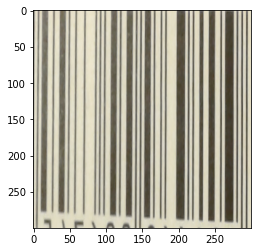

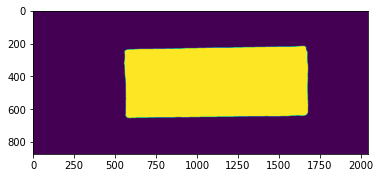

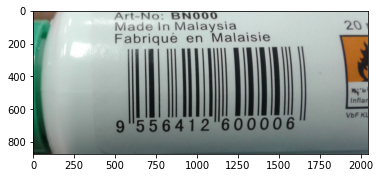

[[[1665  227]]

 [[ 571  240]]

 [[ 564  639]]

 [[1657  639]]]


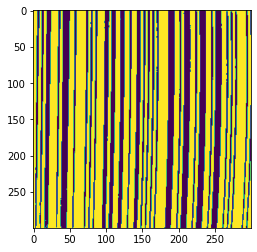

19 0
0 0


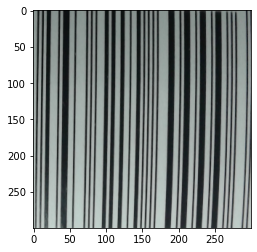

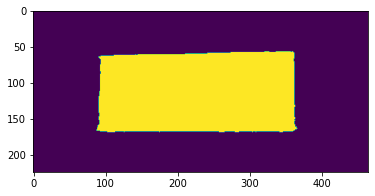

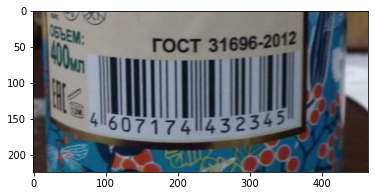

[[[362  59]]

 [[ 91  64]]

 [[ 88 166]]

 [[360 167]]]


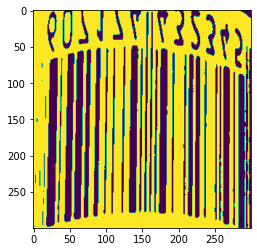

11 0
1 2
rot 180


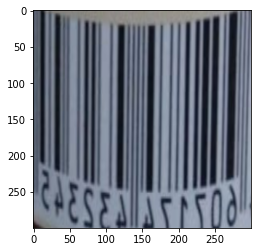

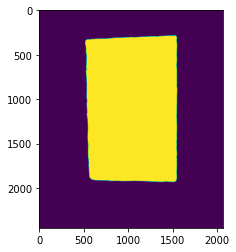

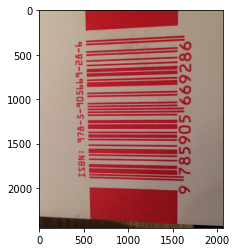

[[[1530  285]]

 [[ 523  339]]

 [[ 582 1897]]

 [[1537 1919]]]


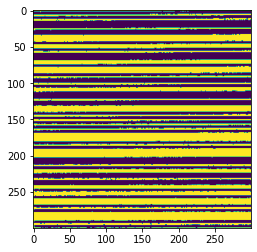

0 59
rot 90
1 0


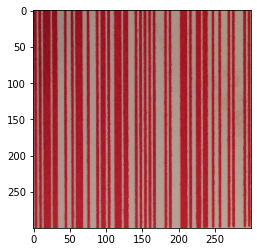

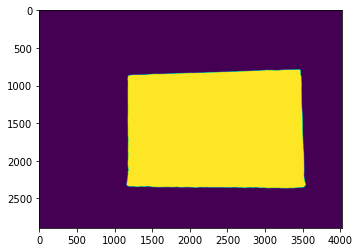

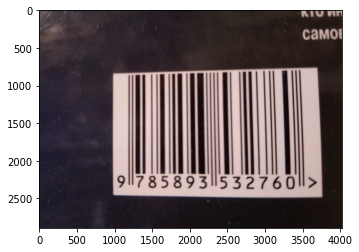

[[[3474  794]]

 [[1188  871]]

 [[1166 2323]]

 [[3529 2344]]]


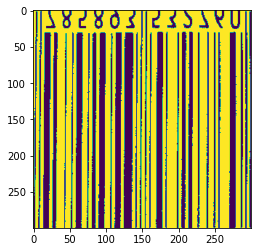

49 0
0 10
rot 180


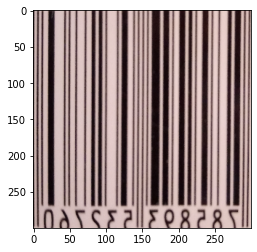

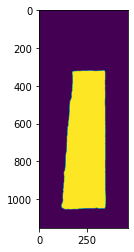

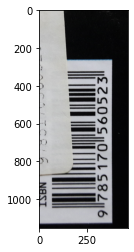

[[[ 342  318]]

 [[ 134 1051]]

 [[ 349 1037]]]
[array([[342, 318]], dtype=int32), [[342, 1051]], array([[ 134, 1051]], dtype=int32), [[134, 318]]]


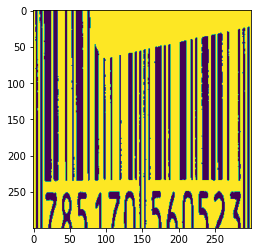

54 0
1 0


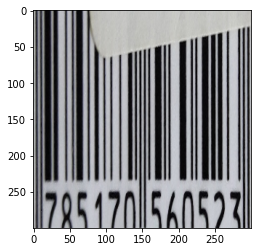

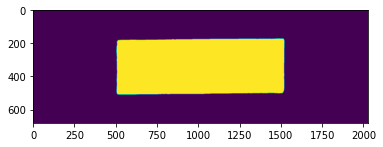

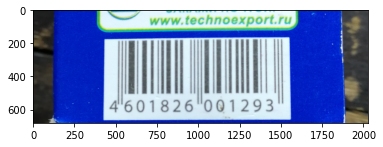

[[[1520  180]]

 [[ 515  181]]

 [[ 507  499]]

 [[1509  500]]]


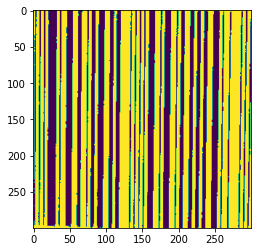

20 0
1 1


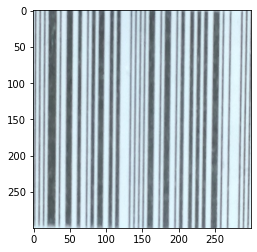

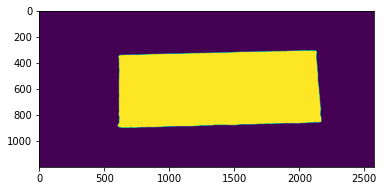

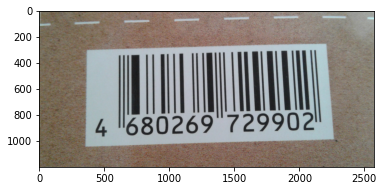

[[[2135  312]]

 [[ 619  340]]

 [[ 605  883]]

 [[2168  853]]]


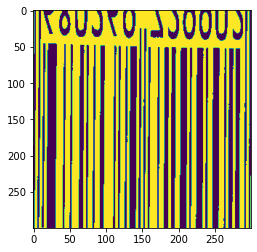

34 0
0 2
rot 180


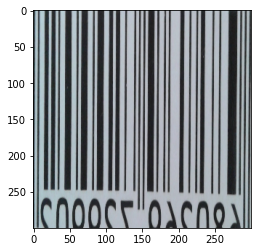

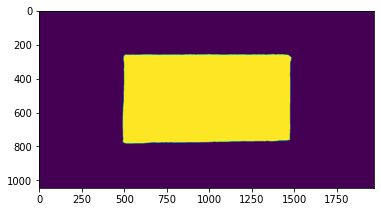

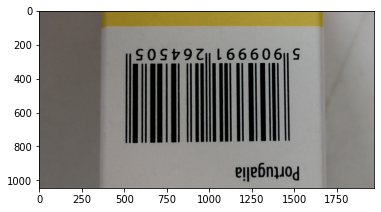

[[[ 500  268]]

 [[ 496  777]]

 [[1476  760]]

 [[1467  263]]]


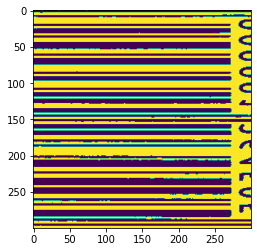

0 59
rot 90
0 7
rot 180


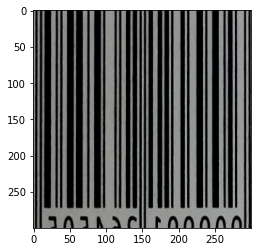

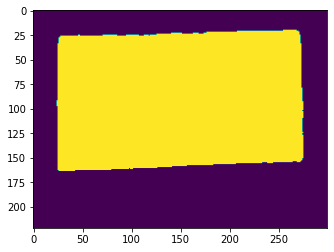

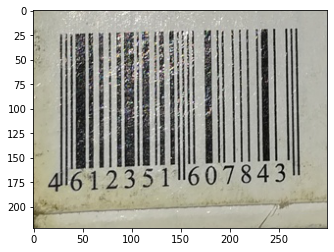

[[[271  22]]

 [[ 28  26]]

 [[ 25 162]]

 [[272 154]]]


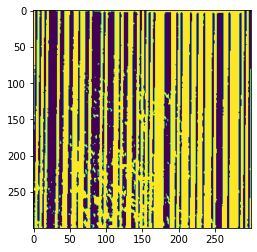

17 0
2 4
rot 180


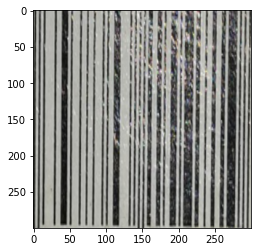

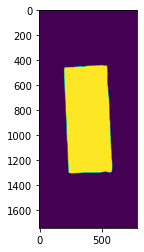

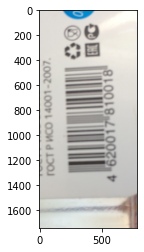

[[[ 538  443]]

 [[ 203  464]]

 [[ 249 1306]]

 [[ 581 1293]]]


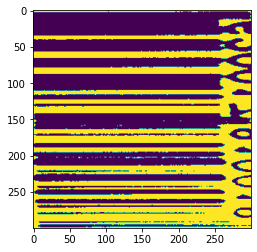

0 32
rot 90
0 4
rot 180


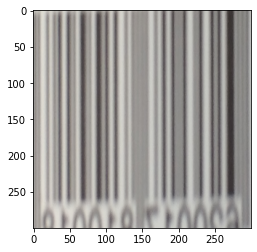

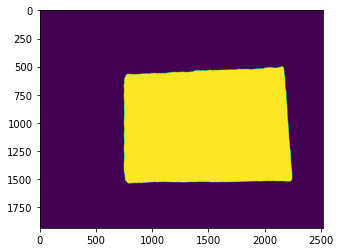

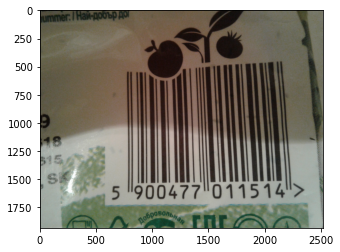

[[[2162  506]]

 [[ 771  568]]

 [[ 758 1510]]

 [[2227 1516]]]


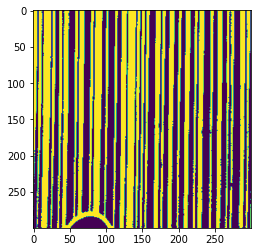

11 0
1 1


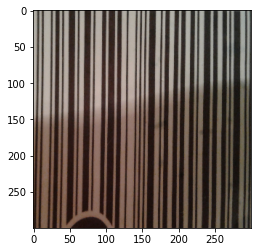

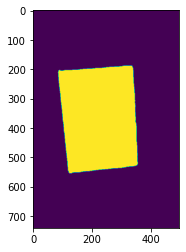

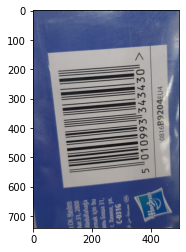

[[[336 189]]

 [[ 87 205]]

 [[124 554]]

 [[355 525]]]


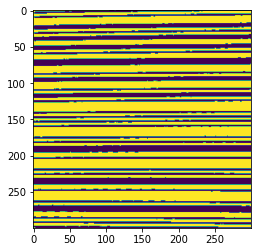

0 42
rot 90
1 0


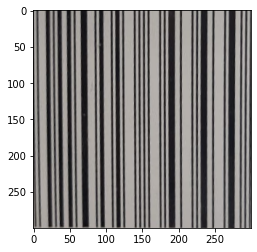

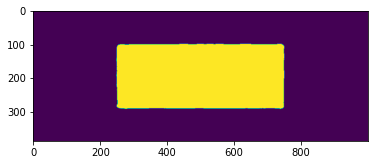

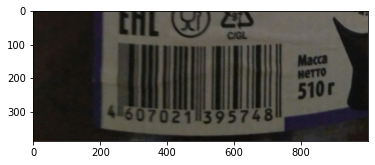

[[[251 104]]

 [[253 288]]

 [[748 286]]

 [[744  99]]]


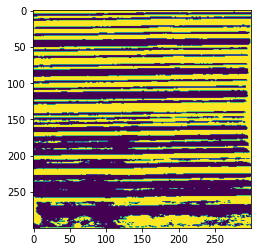

0 2
rot 90
0 2
rot 180


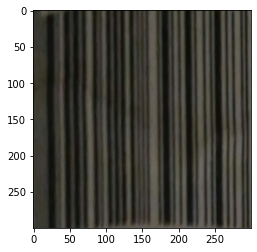

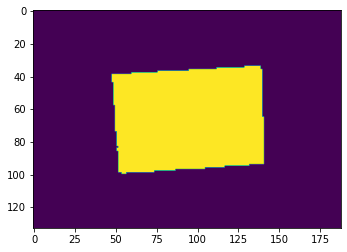

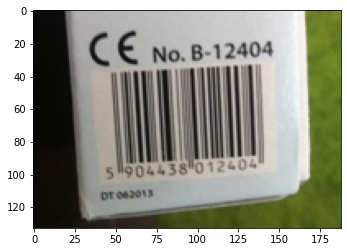

[[[138  34]]

 [[ 48  39]]

 [[ 52  98]]

 [[140  93]]]


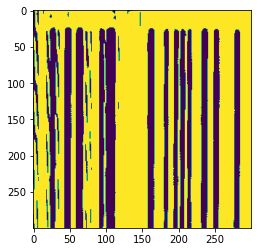

20 0
0 4
rot 180


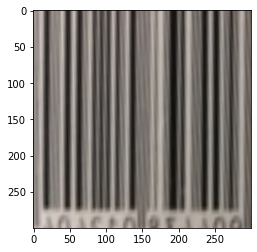

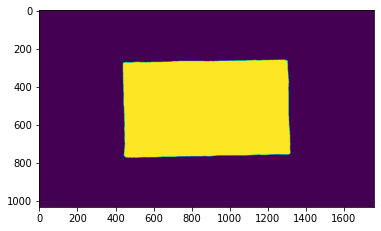

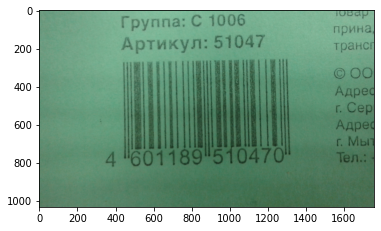

[[[1306  267]]

 [[ 443  275]]

 [[ 447  764]]

 [[1316  754]]]


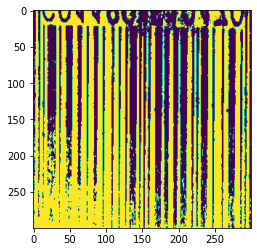

27 0
17 25
rot 180


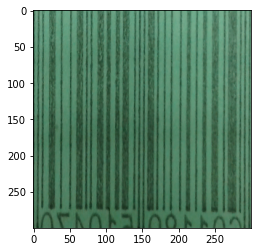

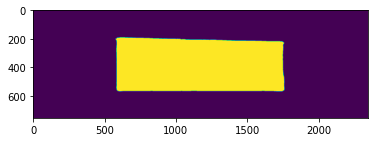

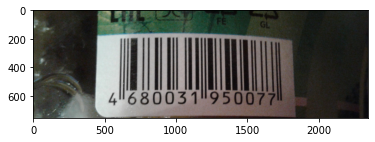

[[[ 577  201]]

 [[ 591  563]]

 [[1759  553]]

 [[1743  218]]]


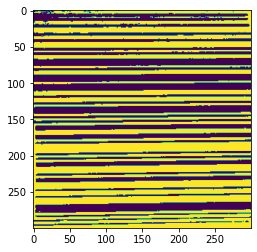

0 21
rot 90
2 0


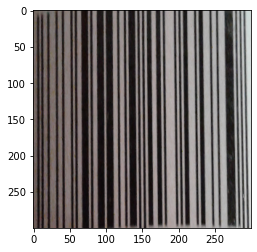

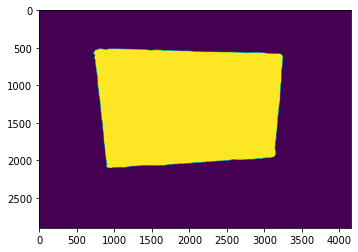

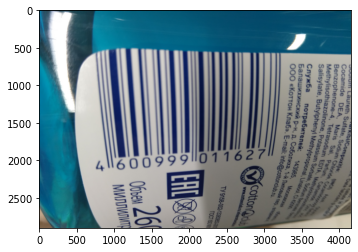

[[[ 721  572]]

 [[ 913 2096]]

 [[3144 1944]]

 [[3230  589]]]


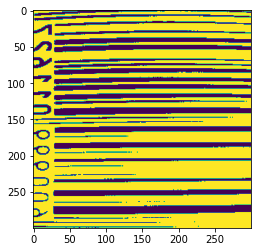

0 21
rot 90
12 0


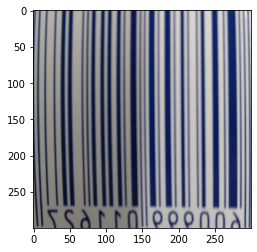

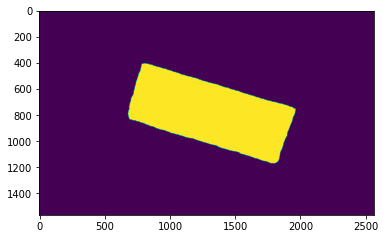

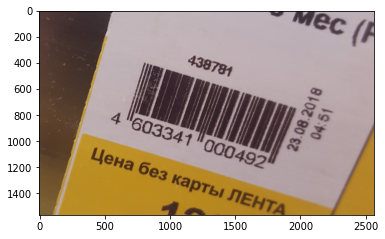

[[[ 787  407]]

 [[ 696  830]]

 [[1831 1152]]

 [[1963  748]]]


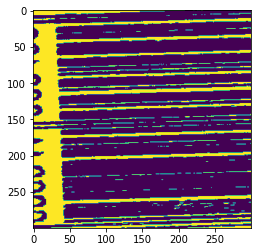

0 0
24 24


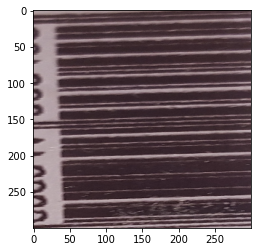

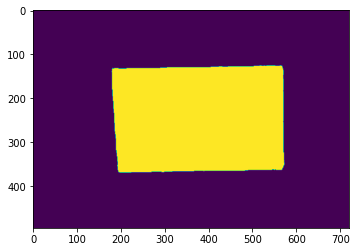

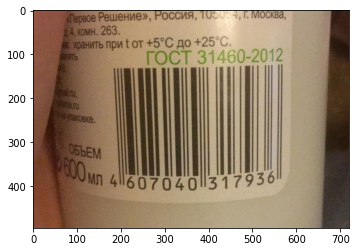

[[[567 127]]

 [[181 132]]

 [[194 367]]

 [[566 363]]]


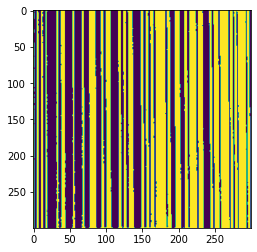

57 0
1 0


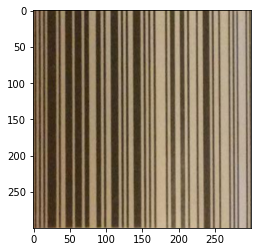

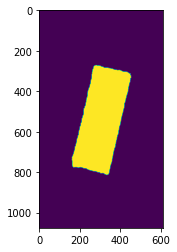

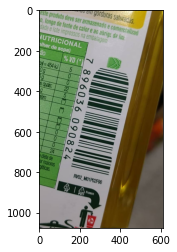

[[[278 272]]

 [[164 767]]

 [[338 812]]

 [[454 324]]]


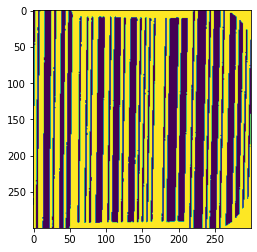

4 0
2 2


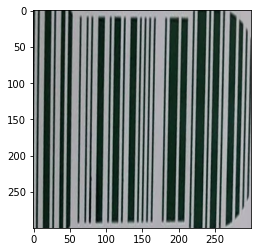

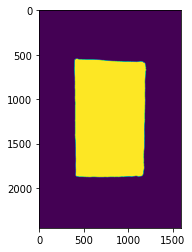

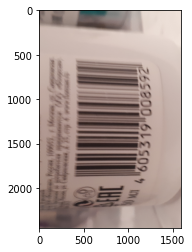

[[[ 413  547]]

 [[ 413 1860]]

 [[1156 1862]]

 [[1188  597]]]


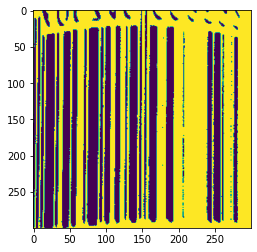

18 0
1 8
rot 180


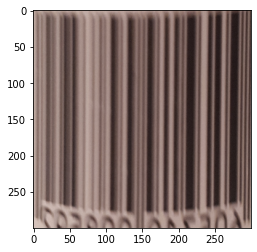

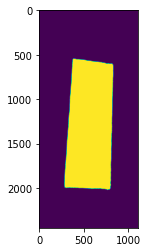

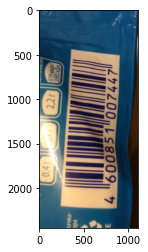

[[[ 388  544]]

 [[ 287 1985]]

 [[ 783 2017]]

 [[ 832  616]]]


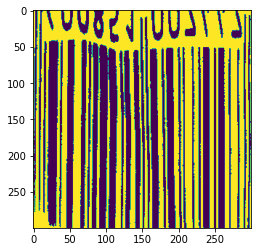

25 0
0 2
rot 180


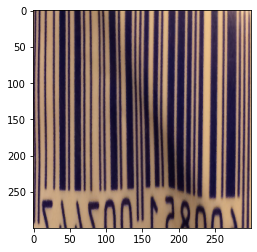

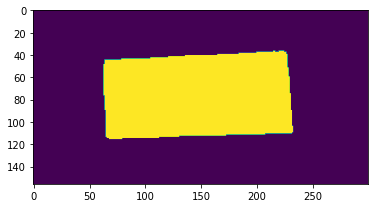

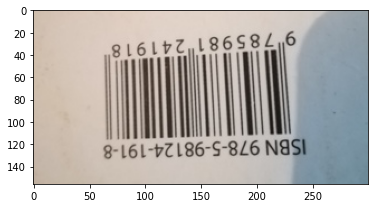

[[[227  40]]

 [[ 64  45]]

 [[ 65 113]]

 [[231 110]]]


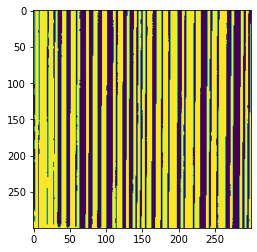

44 0
0 0


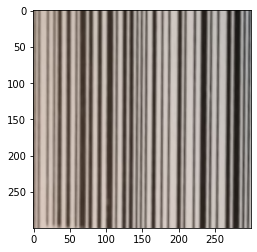

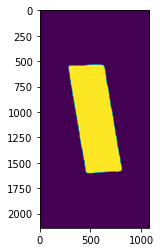

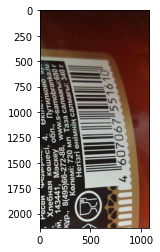

[[[ 292  544]]

 [[ 450 1590]]

 [[ 789 1580]]

 [[ 626  549]]]


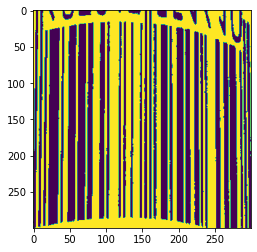

33 0
1 5
rot 180


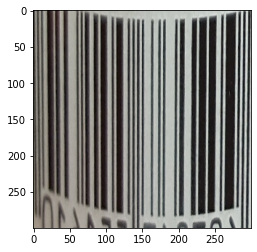

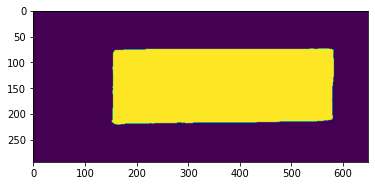

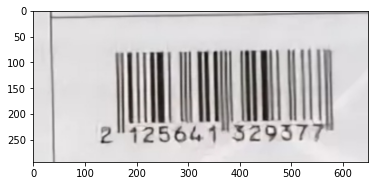

[[[582  78]]

 [[159  77]]

 [[152 214]]

 [[577 211]]]


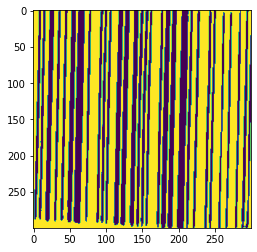

0 0
0 0


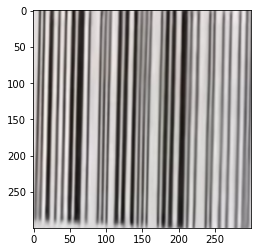

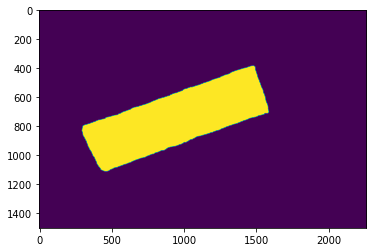

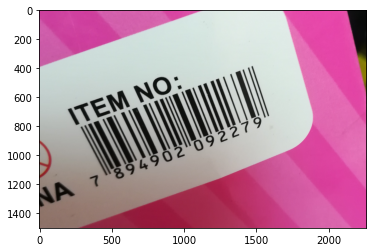

[[[1489  390]]

 [[ 402 1065]]]
[array([[1489,  390]], dtype=int32), [[1489, 1065]], array([[ 402, 1065]], dtype=int32), [[402, 390]]]


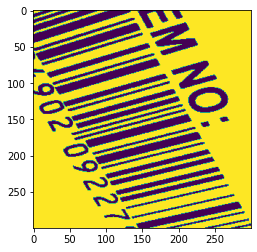

0 0
29 29


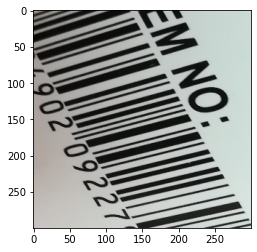

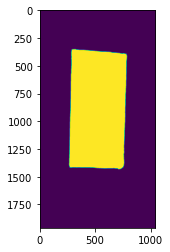

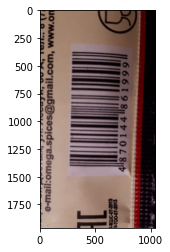

[[[ 288  354]]

 [[ 267 1413]]

 [[ 730 1428]]

 [[ 781  402]]]


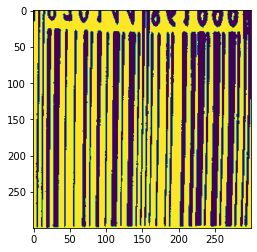

13 0
3 4
rot 180


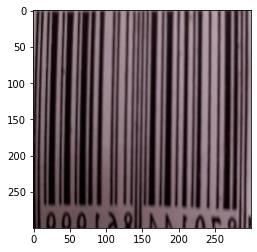

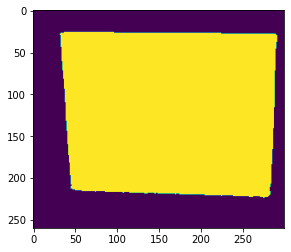

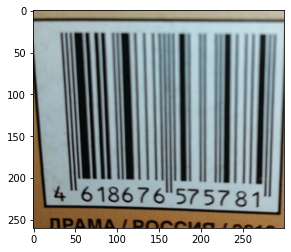

[[[ 32  28]]

 [[ 45 212]]

 [[283 219]]

 [[289  28]]]


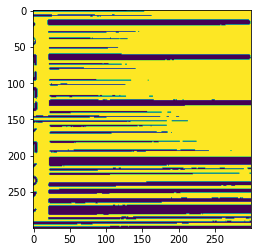

0 21
rot 90
9 0


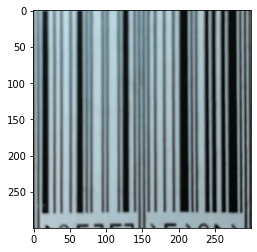

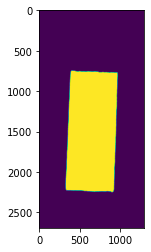

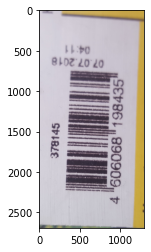

[[[ 401  748]]

 [[ 332 2215]]

 [[ 908 2248]]

 [[ 969  775]]]


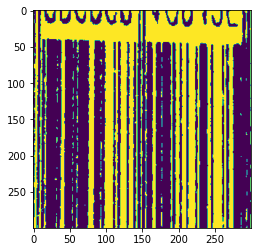

33 0
0 10
rot 180


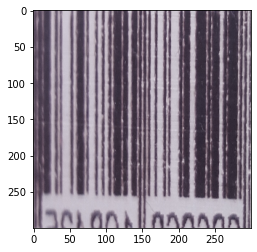

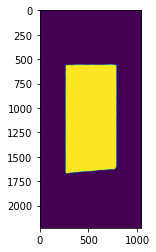

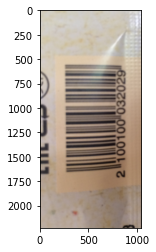

[[[ 771  563]]

 [[ 260  569]]

 [[ 269 1669]]

 [[ 772 1608]]]


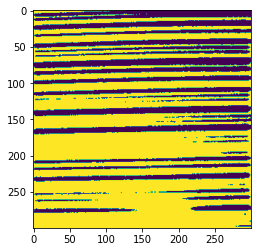

0 2
rot 90
2 4
rot 180


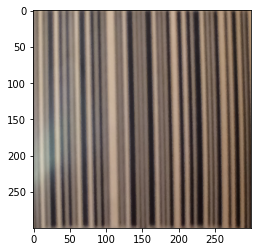

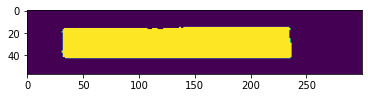

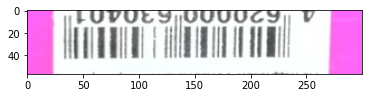

[[[236  29]]

 [[ 31  19]]]
[array([[236,  29]], dtype=int32), [[236, 19]], array([[31, 19]], dtype=int32), [[31, 29]]]


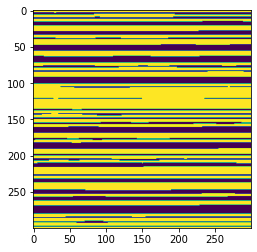

0 60
rot 90
0 0


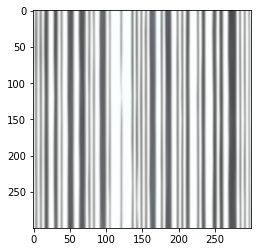

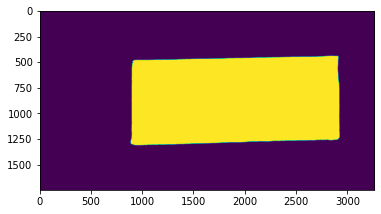

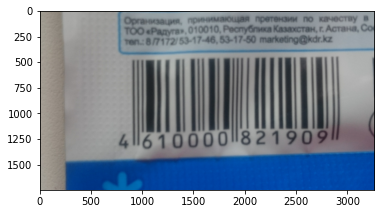

[[[2907  444]]

 [[ 911  480]]

 [[ 882 1284]]

 [[2901 1251]]]


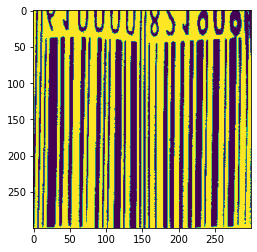

17 0
2 8
rot 180


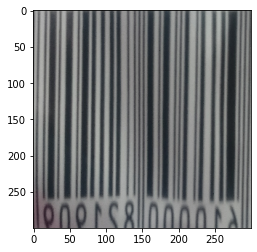

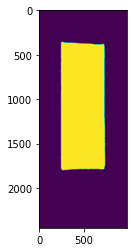

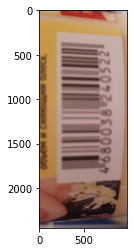

[[[ 255  352]]

 [[ 247 1780]]

 [[ 720 1788]]

 [[ 727  387]]]


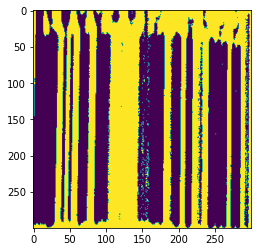

4 0
3 1


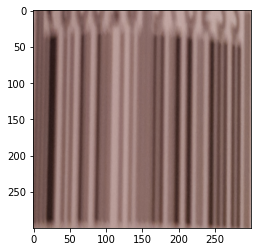

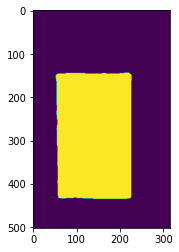

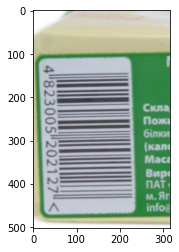

[[[220 144]]

 [[ 53 149]]

 [[ 58 432]]

 [[224 432]]]


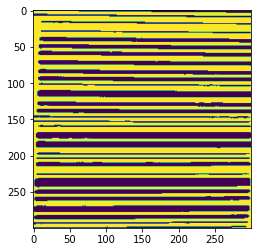

0 44
rot 90
3 2


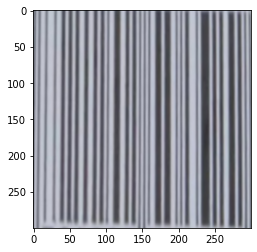

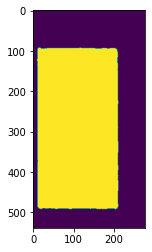

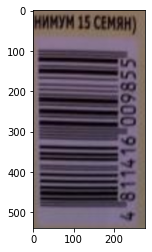

[[[ 13  93]]

 [[ 11 486]]

 [[204 492]]

 [[207  97]]]


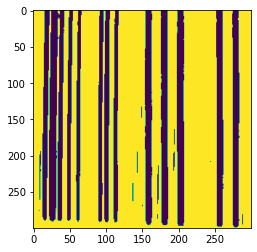

17 0
0 0


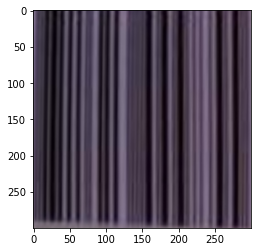

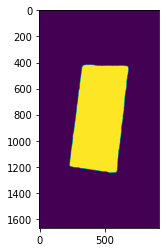

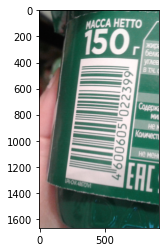

[[[ 342  423]]

 [[ 235 1188]]

 [[ 587 1242]]

 [[ 684  439]]]


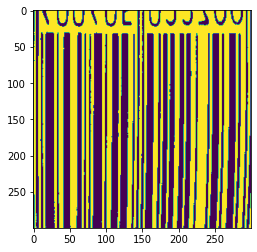

36 0
0 8
rot 180


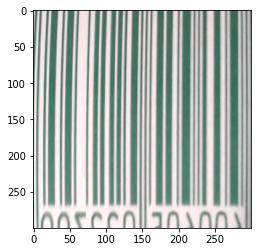

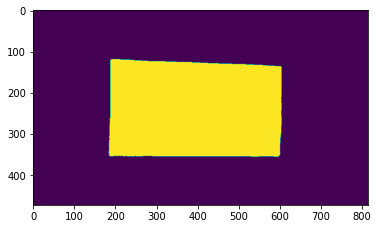

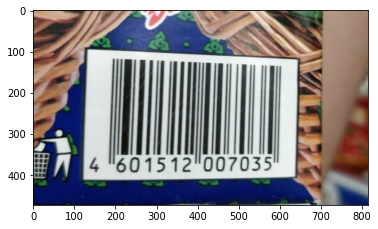

[[[188 121]]

 [[186 353]]

 [[600 351]]

 [[602 136]]]


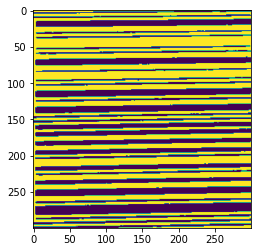

0 7
rot 90
2 0


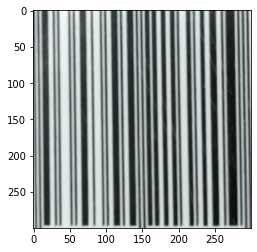

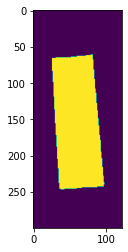

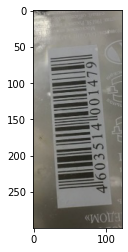

[[[ 81  61]]

 [[ 26  66]]

 [[ 38 246]]

 [[ 97 239]]]


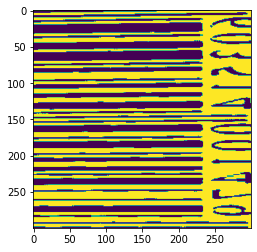

0 20
rot 90
0 0


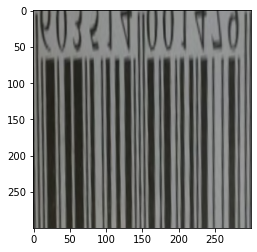

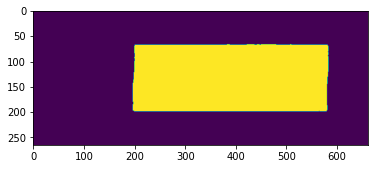

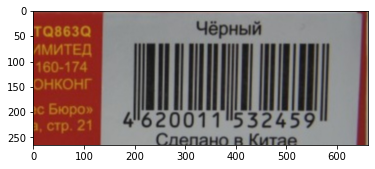

[[[200  70]]

 [[200 198]]

 [[581 195]]

 [[581  68]]]


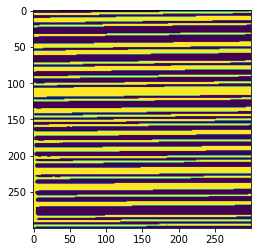

0 20
rot 90
1 0


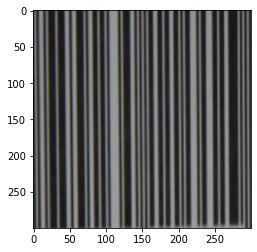

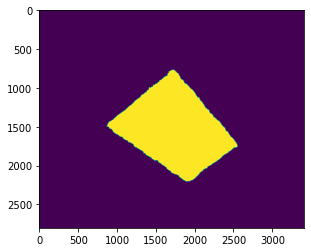

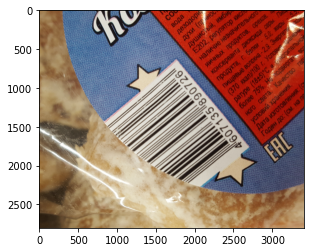

[[[1712  770]]

 [[ 872 1494]]

 [[1913 2204]]

 [[2557 1744]]]


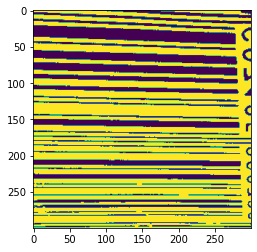

0 27
rot 90
0 11
rot 180


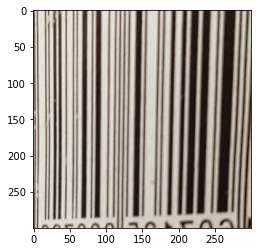

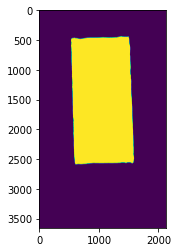

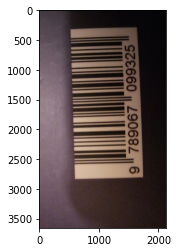

[[[1493  442]]

 [[ 543  478]]

 [[ 611 2584]]

 [[1584 2550]]]


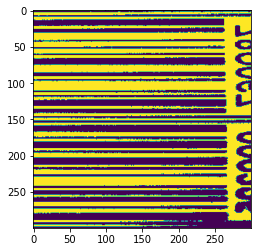

0 50
rot 90
0 14
rot 180


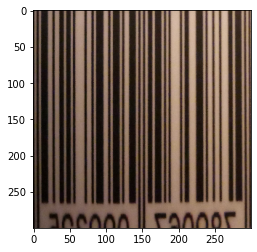

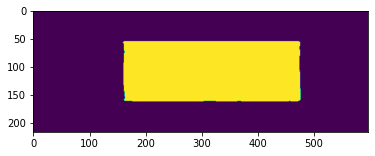

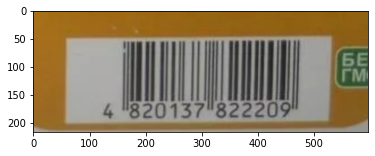

[[[160  57]]

 [[163 160]]

 [[476 158]]

 [[473  55]]]


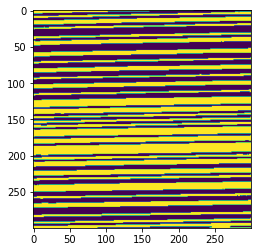

0 1
rot 90
0 0


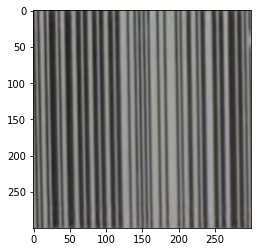

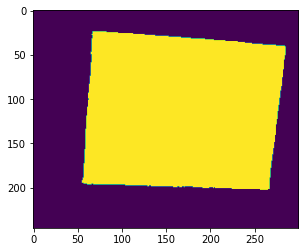

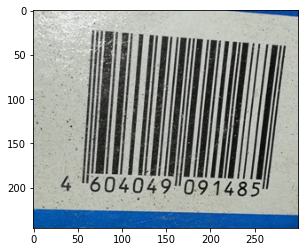

[[[ 67  24]]

 [[ 55 194]]

 [[266 201]]

 [[283  40]]]


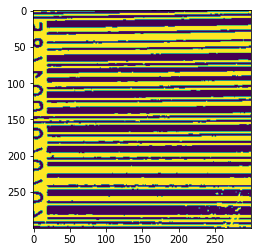

0 31
rot 90
7 0


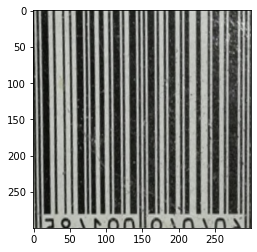

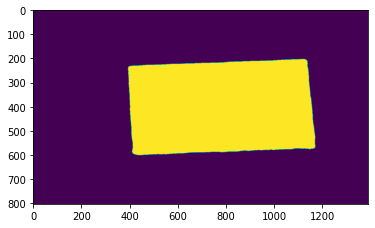

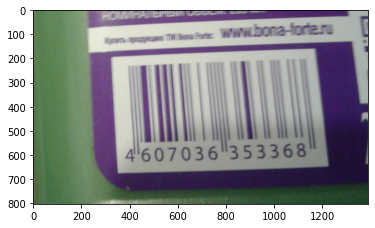

[[[1138  211]]

 [[ 396  234]]

 [[ 412  592]]

 [[1168  571]]]


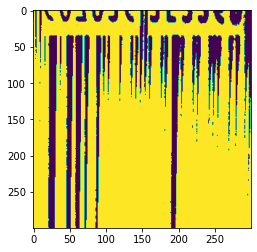

6 0
0 9
rot 180


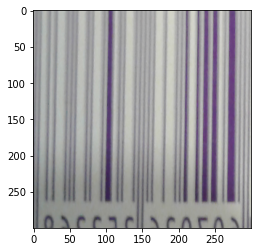

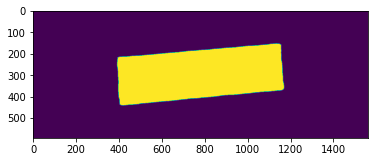

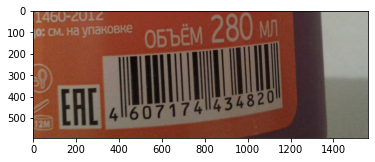

[[[1155  156]]

 [[ 397  215]]

 [[ 404  434]]]
[array([[1155,  156]], dtype=int32), [[1155, 215]], array([[397, 215]], dtype=int32), [[397, 156]]]


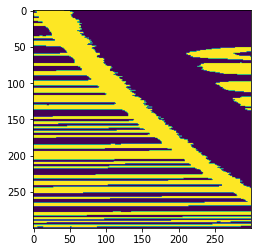

0 20
rot 90
0 0


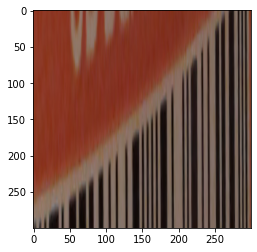

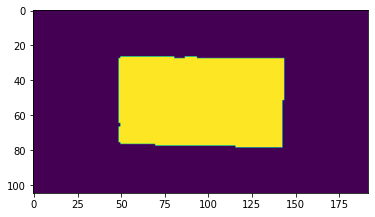

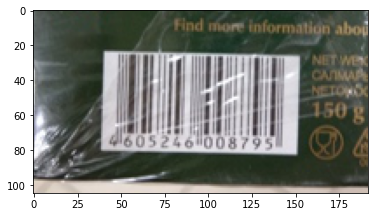

[[[ 49  28]]

 [[ 50  76]]

 [[142  78]]

 [[143  28]]]


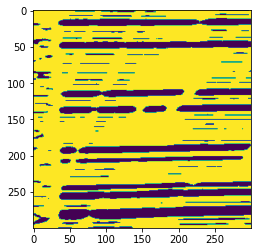

0 0
20 15


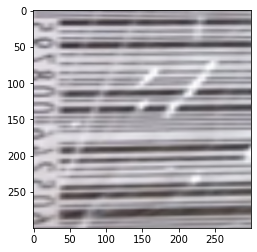

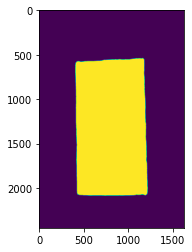

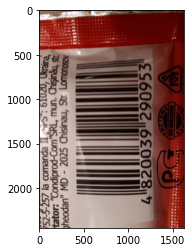

[[[1164  539]]

 [[ 409  598]]

 [[ 440 2073]]

 [[1209 2068]]]


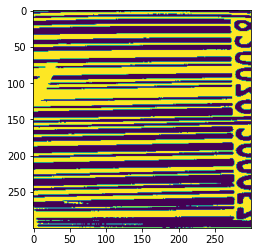

0 6
rot 90
0 16
rot 180


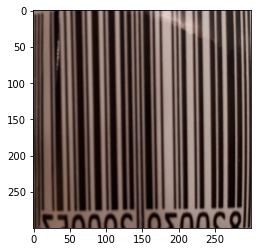

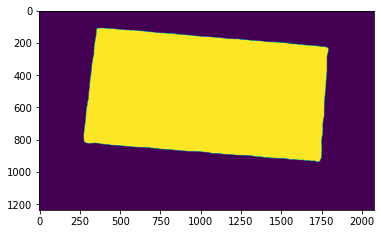

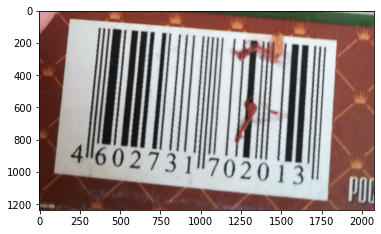

[[[ 355  118]]

 [[ 286  818]]

 [[1741  932]]

 [[1790  233]]]


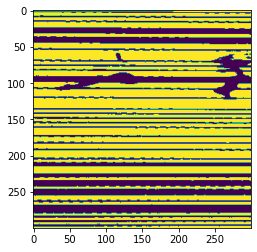

0 54
rot 90
0 0


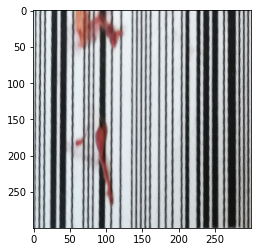

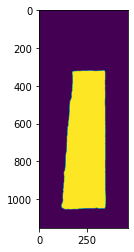

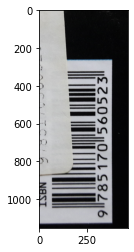

[[[ 342  318]]

 [[ 134 1051]]

 [[ 349 1037]]]
[array([[342, 318]], dtype=int32), [[342, 1051]], array([[ 134, 1051]], dtype=int32), [[134, 318]]]


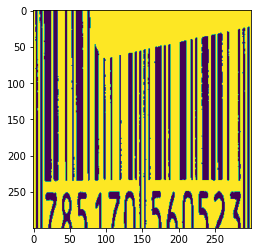

54 0
1 0


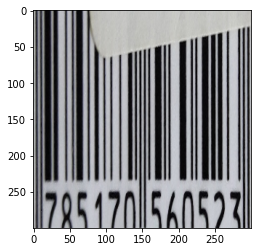

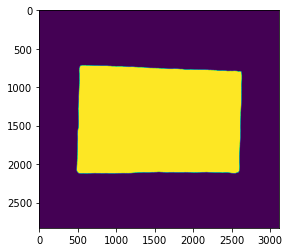

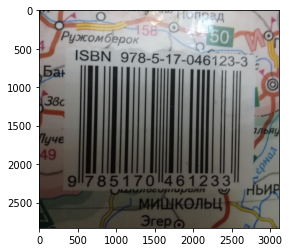

[[[ 533  731]]

 [[ 516 2116]]

 [[2600 2091]]

 [[2625  796]]]


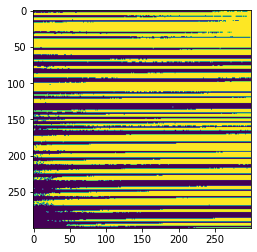

0 44
rot 90
18 0


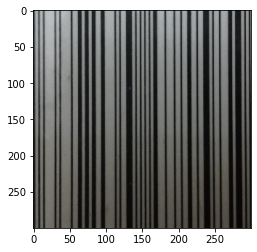

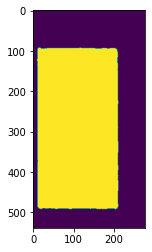

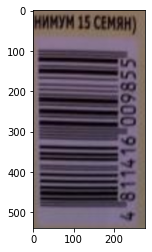

[[[ 13  93]]

 [[ 11 486]]

 [[204 492]]

 [[207  97]]]


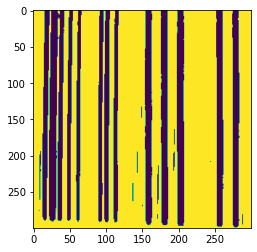

17 0
0 0


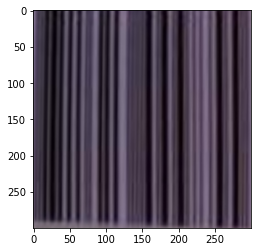

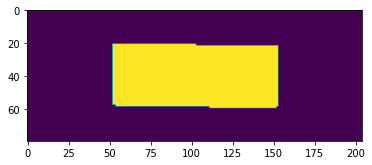

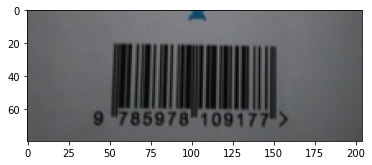

[[[ 52  21]]

 [[ 54  58]]

 [[152  58]]

 [[152  22]]]


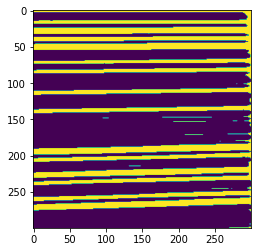

0 10
rot 90
0 3
rot 180


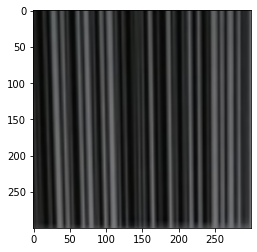

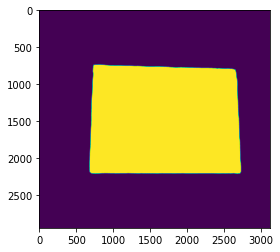

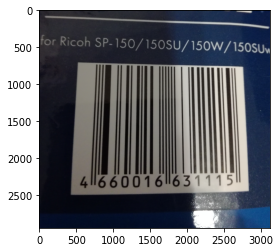

[[[ 736  742]]

 [[ 695 2197]]

 [[2722 2196]]

 [[2653  809]]]


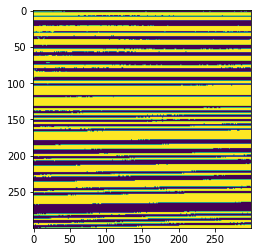

0 40
rot 90
0 0


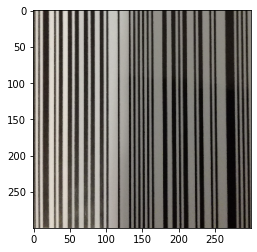

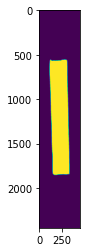

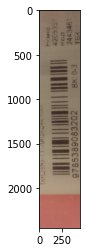

[[[ 284  554]]

 [[ 170 1851]]]
[array([[284, 554]], dtype=int32), [[284, 1851]], array([[ 170, 1851]], dtype=int32), [[170, 554]]]


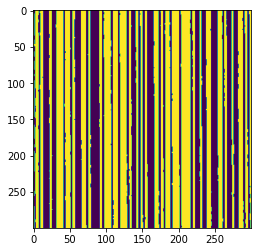

60 0
0 0


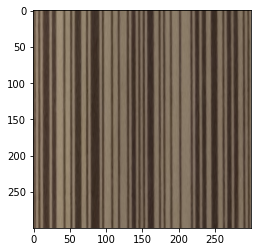

KeyboardInterrupt: 

<Figure size 432x288 with 0 Axes>

In [4]:
Net = Model().to(device)
loss_f = nn.CrossEntropyLoss()
optimizer=torch.optim.Adam(params=Net.parameters(),lr=Learning_Rate) # Create adam optimizer

for itr in range(10000): # Training loop
    barcodes,ann=LoadBatch(onlyfiles_paths_images, dataset) # Load taining batch
    barcodes = barcodes.cuda()
    ann = torch.autograd.Variable(ann, requires_grad=False).to(device) # Load annotation
    Pred = Net(barcodes)
    
    Net.zero_grad()
    Loss = loss_f(Pred[0], ann[0].long())
    
    for i in range(1, len(Pred[0])):
        Loss +=loss_f(Pred[i], ann[i].long()) # Calculate cross entropy loss

    Loss.backward() # Backpropogate loss
    optimizer.step() # Apply gradient descent change to weight
    seg = torch.argmax(Pred[0], 0).cpu().detach().numpy()  # Get  prediction classes
    
    
    if itr % 1000 == 0: #Save model weight once every 60k steps permenant file
        print("Saving Model" +str(itr) + ".torch")
        torch.save(Net.state_dict(),   "Net" + str(itr) + ".torch")
    
    if itr % 100 == 0: 
        print(itr,") Loss=",Loss.data.cpu().numpy())
        print(Pred[0])
        print(ann[0])
        
        plt.imshow(barcodes.detach().cpu().numpy()[0][0])
        plt.show()